## 3b. Fragmented Replay Single Unit Analysis
cross-correlation

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import cupy as cp
import numpy as np
import datajoint as dj
import spyglass as nd
import pandas as pd
import matplotlib.pyplot as plt
import json
import multiprocessing

# ignore datajoint+jupyter async warnings
import warnings
warnings.simplefilter('ignore', category=DeprecationWarning)
warnings.simplefilter('ignore', category=ResourceWarning)

from spyglass.common import (Session, IntervalList,LabMember, LabTeam, Raw, Session, Nwbfile,
                            Electrode,LFPBand,interval_list_intersect)
from spyglass.common import TaskEpoch
import spyglass.spikesorting.v0 as ss

from spyglass.spikesorting.v0 import (SortGroup, 
                                    SortInterval,
                                    SpikeSortingPreprocessingParameters,
                                    SpikeSortingRecording, 
                                    SpikeSorterParameters,
                                    SpikeSortingRecordingSelection,
                                    ArtifactDetectionParameters, ArtifactDetectionSelection,
                                    ArtifactRemovedIntervalList, ArtifactDetection,
                                      SpikeSortingSelection, SpikeSorting,
                                   CuratedSpikeSortingSelection,CuratedSpikeSorting,Curation)
from spyglass.spikesorting.v0.curation_figurl import CurationFigurl,CurationFigurlSelection
from spyglass.spikesorting.v0.spikesorting_curation import MetricParameters,MetricSelection,QualityMetrics
from spyglass.spikesorting.v0.spikesorting_curation import WaveformParameters,WaveformSelection,Waveforms
from spyglass.common.common_position import IntervalPositionInfo, IntervalPositionInfoSelection,IntervalLinearizedPosition

from spyglass.utils.nwb_helper_fn import get_nwb_copy_filename
from pprint import pprint
from spyglass.shijiegu.ripple_detection import removeDataBeforeTrial1
from spyglass.shijiegu.helpers import interpolate_to_new_time
from spyglass.shijiegu.placefield import place_field,placefield_to_peak1dloc
from spyglass.shijiegu.Analysis_SGU import DecodeResultsLinear
warnings.simplefilter("ignore", category=DeprecationWarning)
warnings.simplefilter("ignore", category=ResourceWarning)
warnings.filterwarnings('ignore')

[2024-08-17 18:31:42,438][INFO]: Connecting shijiegu-alt@lmf-db.cin.ucsf.edu:3306
[2024-08-17 18:31:43,172][INFO]: Connected shijiegu-alt@lmf-db.cin.ucsf.edu:3306


In [3]:
from spyglass.shijiegu.helpers import interval_union
from spyglass.shijiegu.Analysis_SGU import TrialChoice,RippleTimes,EpochPos,ExtendedRippleTimes,RippleTimesWithDecode
from spyglass.shijiegu.load import load_run_sessions
from spyglass.shijiegu.singleUnit import (do_mountainSort,electrode_unit,RippleTime2FiringRate,findWaveForms,RippleTime2Index,
                            )
from spyglass.shijiegu.fragmented import permute_frag_cont,find_spike_count_ratio,get_nwb_units,find_firing_cross_correlation
from spyglass.shijiegu.placefield import cell_by_arm

In [4]:
outputFolder='/cumulus/shijie/recording_pilot/eliot/FragmentedReplay/'
isExist = os.path.exists(outputFolder)
if not isExist:
    os.makedirs(outputFolder)

In [7]:
nwb_copy_file_name = "eliot20221022_.nwb"

In [8]:
run_session_ids, run_session_names, pos_session_names = load_run_sessions(nwb_copy_file_name)

*nwb_file_name *epoch    epoch_name     position_inter
+------------+ +-------+ +------------+ +------------+
eliot20221022_ 1         01_Seq2Sleep1  pos 0 valid ti
eliot20221022_ 2         02_Seq2Session pos 1 valid ti
eliot20221022_ 3         03_Seq2Sleep2  pos 2 valid ti
eliot20221022_ 4         04_Seq2Session pos 3 valid ti
eliot20221022_ 5         05_Seq2Sleep3  pos 4 valid ti
eliot20221022_ 6         06_Seq2Session pos 5 valid ti
eliot20221022_ 7         07_Seq2Sleep4  pos 6 valid ti
eliot20221022_ 8         08_Seq2Session pos 7 valid ti
eliot20221022_ 9         09_Seq2Sleep5  pos 8 valid ti
eliot20221022_ 10        10_Seq2Session pos 9 valid ti
eliot20221022_ 11        11_Seq2Sleep6  pos 10 valid t
 (Total: 11)



In [9]:
epoch_num = 3
session_name = run_session_names[epoch_num]
pos_name = pos_session_names[epoch_num]

In [10]:
session_name

'08_Seq2Session4'

In [11]:
ripple_times = pd.DataFrame((RippleTimesWithDecode & 
                             {'nwb_file_name': nwb_copy_file_name, 'interval_list_name': session_name}).fetch1('ripple_times'))

In [39]:
#ripple_times

### Get spike data:
The function `electrode_unit` finds you nwb_units which includes spike times for all units.
Then the function `RippleTime2FiringRate` finds the firing rate in ripples

In [12]:
key = {"nwb_file_name": nwb_copy_file_name,
       "sorter":"mountainsort4",
       "sort_interval_name":session_name}

In [13]:
sort_group_ids = np.unique((QualityMetrics & key).fetch("sort_group_id"))
sort_group_ids_with_good_cell = []
for sort_group_id in sort_group_ids:
    nwb_units = electrode_unit(nwb_copy_file_name,session_name,sort_group_id)
    if len(nwb_units)==0:
        continue
    sort_group_ids_with_good_cell.append(sort_group_id)
print(sort_group_ids_with_good_cell)

[0, 2, 5, 13, 14, 16, 17, 20, 23, 26, 27, 30, 31]


In [14]:
nwb_units_all = get_nwb_units(nwb_copy_file_name,session_name,sort_group_ids_with_good_cell)

### find the firing ratio between frag and cont, define RATIO_THRESHOLD using this histogram

In [15]:
count_ratio, firing_rate_F, firing_rate_C = find_spike_count_ratio(nwb_units_all,ripple_times)

### Define `cells_frag` and `cells_cont` for cells that engage preferentially with fragmented replays

In [16]:
RATIO_FRAG = 1.5
RATIO_CONT = 0.5
cells_cont = []
cells_frag = []

for e in sort_group_ids_with_good_cell:
    for u in list(firing_rate_F[e].keys()):

        (rate_F, count_F, _) = firing_rate_F[e][u]
        print('electrode '+ str(e) + ' unit ' + str(u))
        print('during fragmented replay: ',rate_F, count_F)
    
        (rate_C, count_C, _) = firing_rate_C[e][u]
        print('during cont replay: ',rate_C, count_C)
        if count_C == 0 and count_F > 2:
            cells_frag.append((e,u))
            continue
    
        if count_C > 0 and count_F/count_C > RATIO_FRAG:
            cells_frag.append((e,u))
        elif count_C > 0 and count_F/count_C < RATIO_CONT:
            cells_cont.append((e,u))

electrode 0 unit 3
during fragmented replay:  7.304430676138095 31.0
during cont replay:  3.709264109928835 84.0
electrode 0 unit 4
during fragmented replay:  0.23562679600445469 1.0
during cont replay:  0.04415790607058137 1.0
electrode 0 unit 6
during fragmented replay:  2.8275215520534562 12.0
during cont replay:  1.9871057731761617 45.0
electrode 0 unit 7
during fragmented replay:  3.5344019400668203 15.0
during cont replay:  0.7506844031998833 17.0
electrode 0 unit 8
during fragmented replay:  1.1781339800222734 5.0
during cont replay:  0.1324737182117441 3.0
electrode 2 unit 3
during fragmented replay:  2.356267960044547 10.0
during cont replay:  1.1481055578351156 26.0
electrode 5 unit 2
during fragmented replay:  0.0 0.0
during cont replay:  0.9273160274822088 21.0
electrode 5 unit 5
during fragmented replay:  2.120641164040092 9.0
during cont replay:  0.30910534249406957 7.0
electrode 5 unit 6
during fragmented replay:  0.23562679600445469 1.0
during cont replay:  0.0 0.0
elec

### A. Find cross-correlation

In [17]:
cell_list = []
for e in sort_group_ids_with_good_cell:
    for u in nwb_units_all[e].index:
        cell_list.append((e, u))

In [18]:
# 10 ms bins
DELTA_T = 0.01
firing_corr_cont, pairs_cont, ripple_ind_cont, lag_cont = find_firing_cross_correlation(ripple_times, 
                                                                      nwb_units_all, cell_list, cont = True,
                                                                      DELTA_T = DELTA_T)
firing_corr_frag, pairs_frag, ripple_ind_frag, lag_frag = find_firing_cross_correlation(ripple_times, 
                                                                      nwb_units_all, cell_list, cont = False,
                                                                      DELTA_T = DELTA_T)

### quick query correlation for a pair of neuron

In [21]:
from spyglass.shijiegu.fragmented_graph import cell_name_to_ind

In [57]:
query_cell_name = [(17,4),(20,7)]

In [58]:
query_cell_ind = [cell_name_to_ind(cell_name,cell_list) for cell_name in query_cell_name]

In [59]:
query_cell_ind

[45]

In [54]:
col_ind_frag = np.argwhere(np.sum(np.isin(pairs_frag,query_cell_ind),axis = 1) == 2).ravel()
col_ind_cont = np.argwhere(np.sum(np.isin(pairs_cont,query_cell_ind),axis = 1) == 2).ravel()

In [55]:
col_ind_frag

array([ 308,  481, 1558, 2260, 2951])

In [56]:
col_ind_cont

array([], dtype=int64)

In [32]:
ripple_times.loc[ripple_ind_cont[col_ind_cont]]

,start_time,end_time,animal_location,trial_number,cont_intvl,frag_intvl,cont_intvl_replay,duration,mean_zscore,median_zscore,max_zscore,min_zscore,speed_at_start,speed_at_end,max_speed,min_speed,median_speed,mean_speed
8,1.666477e+09,1.666477e+09,home,2,"[[1666477201.7952251, 1666477201.8772252], [16...",[],"[[2], [0]]",0.215,3.631993,1.186211,23.126834,-0.610710,3.969947,3.969912,3.969947,3.969902,3.969911,3.969914
37,1.666477e+09,1.666477e+09,home,10,"[[1666477431.9891963, 1666477432.1331966]]",[],"[[0, 2]]",0.152,2.502801,1.406683,7.945340,-0.319602,1.265173,1.265196,1.265196,1.265173,1.265183,1.265183
96,1.666478e+09,1.666478e+09,well3,43,"[[1666478131.0731096, 1666478131.1451097], [16...","[[1666478131.2631097, 1666478131.3271098]]","[[1], [2], []]",0.313,1.973672,1.287841,6.307779,0.036499,0.568163,0.568164,0.568165,0.568162,0.568164,0.568164
111,1.666478e+09,1.666478e+09,home,50,"[[1666478264.887093, 1666478265.0730932], [166...",[],"[[2], []]",0.251,3.111933,2.439410,11.110571,-0.868374,1.244790,1.244770,1.244790,1.244767,1.244770,1.244775


### a. For pairs of continuous cells with place field on the same arm

#### 1. first find place fields

In [60]:
placefields = {}
mobility_spike_counts = {}
all_spike_counts = {}
peak_frs = {}
for row_ind in range(len(cell_list)):
    print(row_ind)
    e = cell_list[row_ind][0]
    u = cell_list[row_ind][1]
    placefield, peak_fr, xbins, ybins, mobility_spike_count, all_spike_count = place_field(
        nwb_copy_file_name, session_name, pos_name, e, u)
    placefields[(e,u)] = placefield
    peak_frs[(e,u)] = peak_fr
    mobility_spike_counts[(e,u)] = mobility_spike_count
    all_spike_counts[(e,u)] = all_spike_count

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89


#### 2. get peak location

In [61]:
peak1ds={}
peak1ds_list = []

for row_ind in range(len(cell_list)):
    print(row_ind)
    e = cell_list[row_ind][0]
    u = cell_list[row_ind][1]
    peak1d = placefield_to_peak1dloc('4 arm lumped 2023', placefields[(e,u)], ybins, xbins)
    peak1ds[(e,u)] = peak1d
    peak1ds_list.append(peak1d)

[19:26:38][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:38][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:38][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:38][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:38][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:38][WARNING] Spyglass: 

0
1
2
3
4
5
6
7
8
9
10
11
12


[19:26:38][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:38][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:38][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:38][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:38][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:38][WARNING] Spyglass: 

13
14
15
16
17
18
19
20
21
22
23
24
25
26
27


[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: 

28
29
30
31
32
33
34
35
36
37
38
39
40
41
42


[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: 

43
44
45
46
47
48
49
50
51
52
53
54
55
56
57


[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: 

58
59
60
61
62
63
64
65
66
67
68
69
70
71
72


[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[19:26:39][WARNING] Spyglass: 

73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88


[19:26:39][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


89


#### 3. group cells with place field peak on one arm

In [62]:
cell_list_by_arm, cell_list_ind_by_arm = cell_by_arm(peak1ds_list, cell_list)

[19:26:40][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


In [63]:
def find_pairs(cell_list_by_arm, cell_list_ind_by_arm, pairs_frag, pairs_cont, arm = 'arm1'):
    """
    find pairs that have sufficient number of co-firing in the same ripple, continuous or fragmented
    pairs_frag, pairs_cont are output from xcorr()
    """
    
    pairs_frag_ind = np.argwhere(np.sum(np.isin(pairs_frag,
                               cell_list_ind_by_arm[arm]),axis = 1) == 2).ravel()
    pairs_frag_cell_ind = pairs_frag[pairs_frag_ind] #pairs in the first dimension
    
    pairs_cont_ind = np.argwhere(np.sum(np.isin(pairs_cont,
                               cell_list_ind_by_arm[arm]),axis = 1) == 2).ravel()
    pairs_cont_cell_ind = pairs_cont[pairs_cont_ind] #pairs in the first dimension

    # find cells that are common
    pairs_by_arm_ind = []
    for p in np.arange(pairs_cont_cell_ind.shape[0]):
        cell1 = pairs_cont_cell_ind[p][0]
        cell2 = pairs_cont_cell_ind[p][1]
    
        # find it in frag
        for p2 in np.arange(pairs_frag_cell_ind.shape[0]):
            cell1_f = pairs_frag_cell_ind[p2][0]
            cell2_f = pairs_frag_cell_ind[p2][1]
            if cell1 == cell1_f and cell2 == cell2_f:
                pairs_by_arm_ind.append([cell1,cell2])
                
    pairs_by_arm_ind = np.unique(pairs_by_arm_ind, axis = 0)

    # further restrict to those that have more than 2 cofiring
    tmp = []
    for pair in pairs_by_arm_ind:
        # find cont correlation time
        col_ind1 = np.argwhere(np.sum(np.isin(pairs_cont,pair),axis = 1) == 2).ravel()
        
        # find frag correlation time
        col_ind2 = np.argwhere(np.sum(np.isin(pairs_frag,pair),axis = 1) == 2).ravel()
        
        if len(col_ind1) > 2 and len(col_ind2) > 2:
            tmp.append(pair)
    
    return tmp

In [195]:
pairs_by_arm_ind = {}
for a in ['home','arm1','arm2','arm3','arm4']:
    pairs_by_arm_ind[a] = find_pairs(cell_list_by_arm, cell_list_ind_by_arm, pairs_frag, pairs_cont, arm = a)

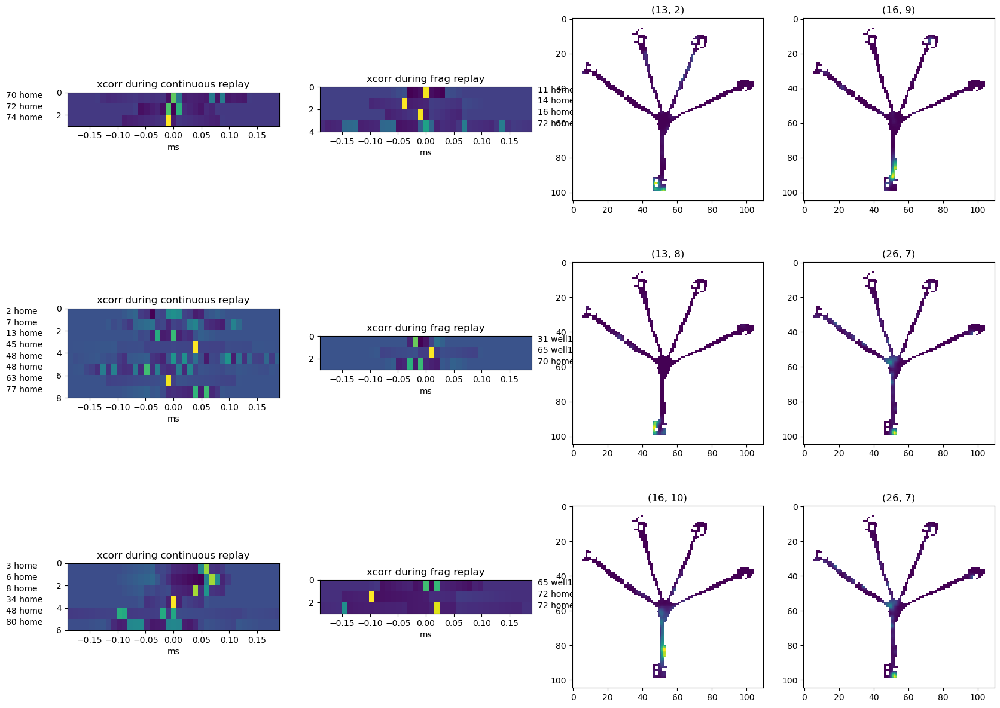

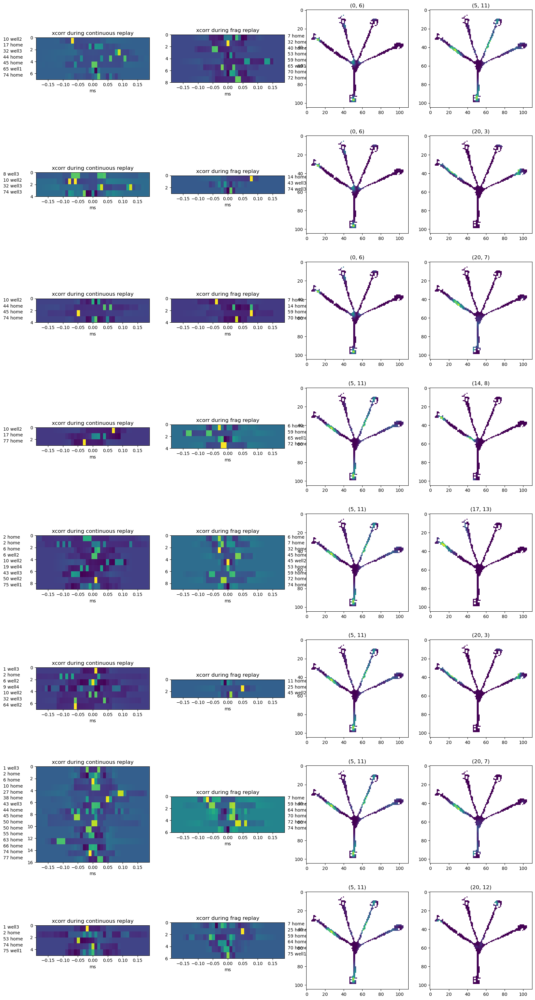

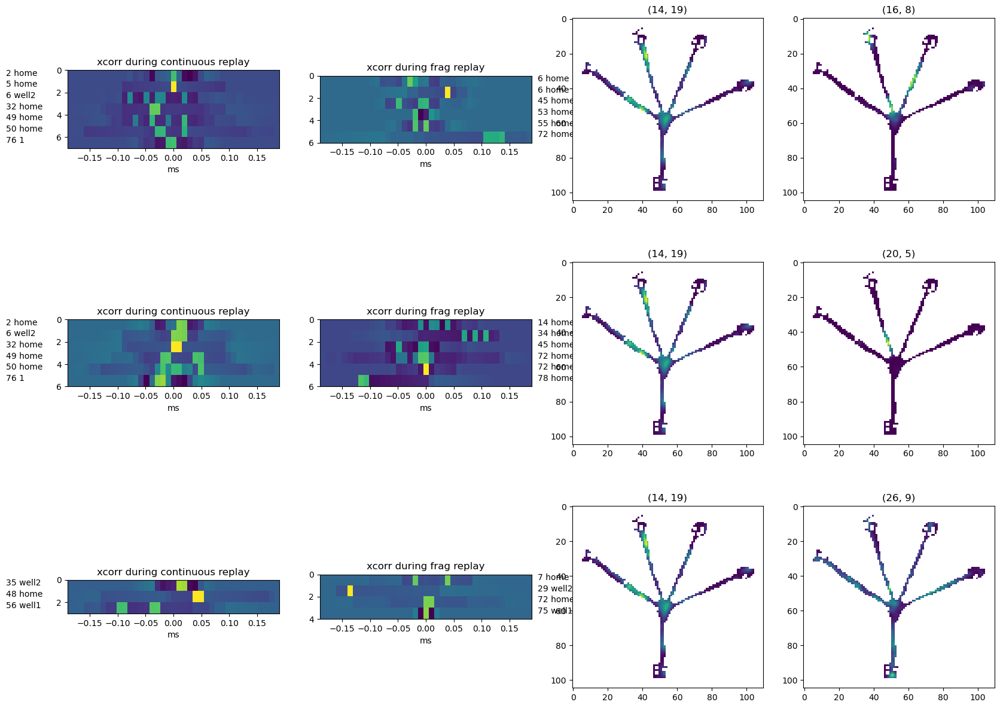

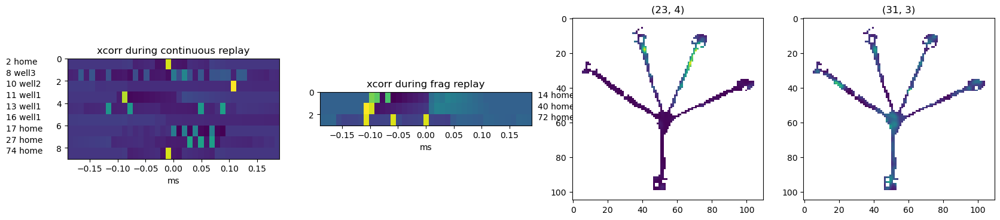

In [231]:
#a = 'arm1'

for a in ['home','arm1','arm2','arm3','arm4']:
    savename = session_name+'_'+a+'xcorr'
    if len(pairs_by_arm_ind_plot[a]) == 0:
        continue
    fig, axes = plt.subplots(len(pairs_by_arm_ind_plot[a]),4,
                             figsize = (20,5 * len(pairs_by_arm_ind_plot[a])),sharex = 0,squeeze = False,
                             gridspec_kw={"width_ratios": [1,1,0.9,0.9]})

    for pair_ind in range(len(pairs_by_arm_ind_plot[a])):
        pair = pairs_by_arm_ind_plot[a][pair_ind]
        
        # find cont correlation time
        col_ind = np.argwhere(np.sum(np.isin(pairs_cont,pair),axis = 1) == 2).ravel()
        firing_corr_cont_p = firing_corr_cont[:,col_ind]
        ripple_ind_cont_p = ripple_ind_cont[col_ind]
        
        # find frag correlation time
        col_ind = np.argwhere(np.sum(np.isin(pairs_frag,pair),axis = 1) == 2).ravel()
        firing_corr_frag_p = firing_corr_frag[:,col_ind]
        ripple_ind_frag_p = ripple_ind_frag[col_ind]
        
        cell1 = cell_list[pair[0]]
        cell2 = cell_list[pair[1]]
        
        # plot
        
        row_num = firing_corr_cont_p.shape[1]
        axes[pair_ind,0].imshow(firing_corr_cont_p.T, aspect = 0.02, extent = [lag_cont[0] * DELTA_T, lag_cont[-1] * DELTA_T,row_num,0]);
        axes[pair_ind,0].set_xlabel('ms')
        axes[pair_ind,0].set_title('xcorr during continuous replay')
        for r_ind in range(len(ripple_ind_cont_p)):
            entry = ripple_times.loc[ripple_ind_cont_p[r_ind]]
            axes[pair_ind,0].text(-0.3,r_ind+0.5,str(entry.trial_number)+' '+entry.animal_location)
        
        row_num = firing_corr_frag_p.shape[1]
        axes[pair_ind,1].imshow(firing_corr_frag_p.T, aspect = 0.02, extent = [lag_frag[0] * DELTA_T, lag_frag[-1] * DELTA_T,row_num,0]);
        axes[pair_ind,1].set_xlabel('ms')
        axes[pair_ind,1].set_title('xcorr during frag replay')
        for r_ind in range(len(ripple_ind_frag_p)):
            entry = ripple_times.loc[ripple_ind_frag_p[r_ind]]
            axes[pair_ind,1].text(0.2,r_ind+0.5,str(entry.trial_number)+' '+entry.animal_location)
        
        
        axes[pair_ind,2].imshow(placefields[cell1])
        axes[pair_ind,2].set_title(cell1)
        
        axes[pair_ind,3].imshow(placefields[cell2])
        axes[pair_ind,3].set_title(cell2)
        if len(outputFolder)>0:
            plt.savefig(os.path.join(outputFolder,savename+'.pdf'),format="pdf",bbox_inches='tight',dpi=200)

        


In [317]:
#other_cell1 = np.array(cell_list)[pairs_frag[col_ind1,1]]

#### 4. fragmented replay preference cells

In [365]:
def find_xcorr_col_frag(cell,cell_list,pairs_frag,firing_corr_frag,ripple_ind_frag):
    
    cell_ind = np.argwhere(np.sum(np.array(cell_list) == cell,axis = 1) == 2).ravel()[0]
    col_ind1 = np.argwhere(pairs_frag[:,0] == cell_ind).ravel()
    col_ind2 = np.argwhere(pairs_frag[:,1] == cell_ind).ravel()
    other_cell1 = np.array(cell_list)[pairs_frag[col_ind1,1]]
    other_cell2 = np.array(cell_list)[pairs_frag[col_ind2,0]]
    
    firing_corr_frag_p1 = firing_corr_frag[:,col_ind1]
    ripple_ind_frag_p1 = ripple_ind_frag[col_ind1]
    firing_corr_frag_p2 = firing_corr_frag[:,col_ind2]
    ripple_ind_frag_p2 = ripple_ind_frag[col_ind2]
    
    firing_corr_frag_p = np.concatenate((firing_corr_frag_p1,np.flipud(firing_corr_frag_p2)),axis = 1)
    ripple_ind_frag_p = np.concatenate((ripple_ind_frag_p1,ripple_ind_frag_p2))
    other_cell = np.concatenate((other_cell1,other_cell2))
    other_cell_ind = np.concatenate((pairs_frag[col_ind1,1],pairs_frag[col_ind2,0]))
    return firing_corr_frag_p, ripple_ind_frag_p, other_cell, other_cell_ind

In [366]:
def sort_by_peak(other_cell_ind):
    
    col_ind_all = []
    peak_loc_all = []
    for arm in ['home','arm1','arm2','arm3','arm4']:
        col_ind = np.argwhere(np.isin(other_cell_ind,cell_list_ind_by_arm[arm])).ravel()
        
        # further sort by cell identity
        col_ind = col_ind[np.argsort(other_cell_ind[col_ind])]
        
        col_ind_all.append(col_ind)
        peak_loc_all.append([arm for c in range(len(col_ind))])
    
    col_ind_all = np.concatenate(col_ind_all)
    peak_loc_all = np.concatenate(peak_loc_all)
    return col_ind_all,peak_loc_all


#### xcorr with others during frag replay

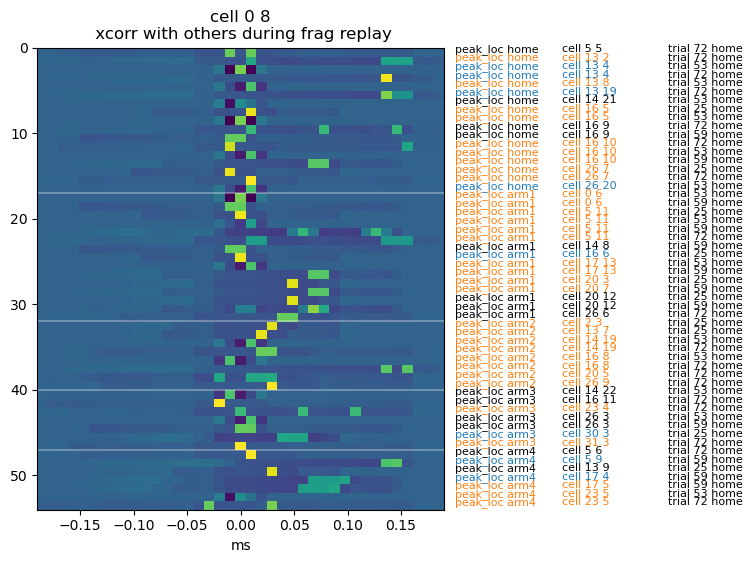

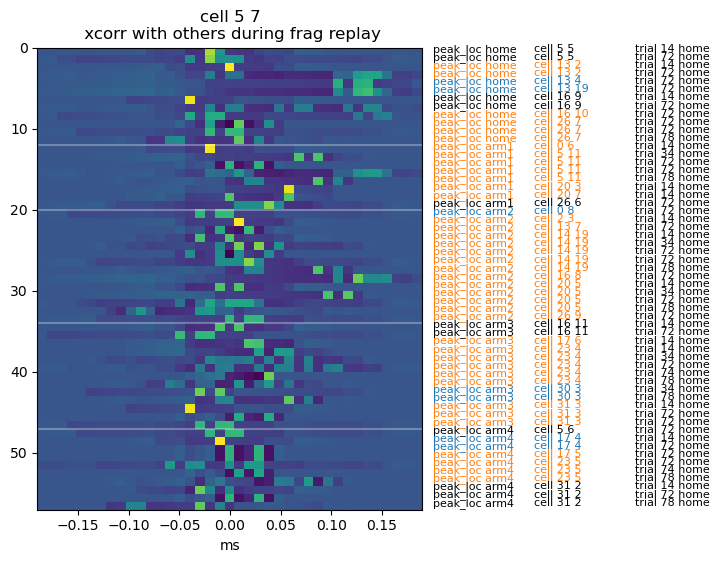

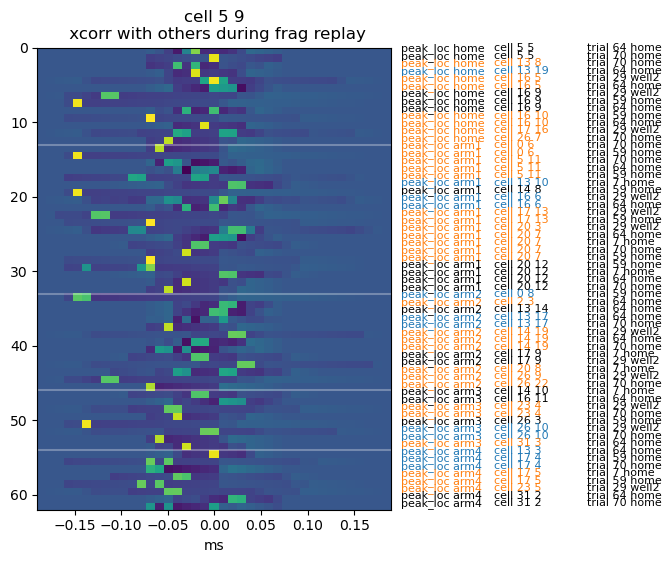

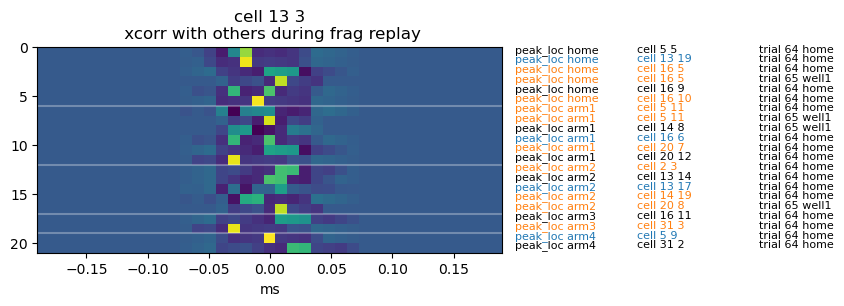

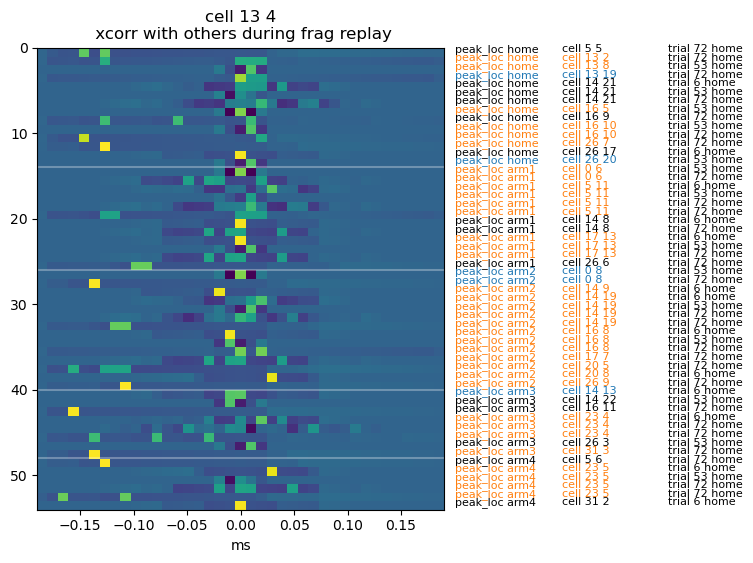

...

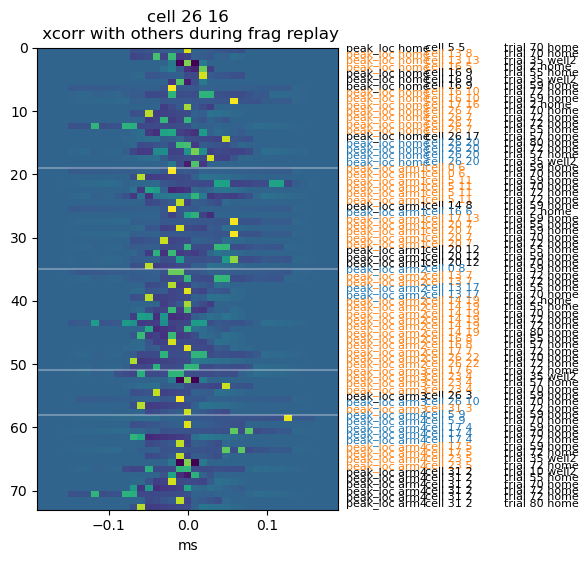

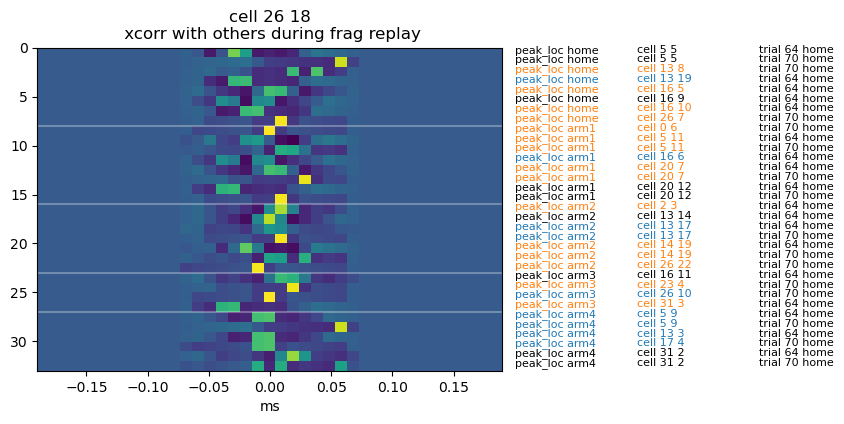

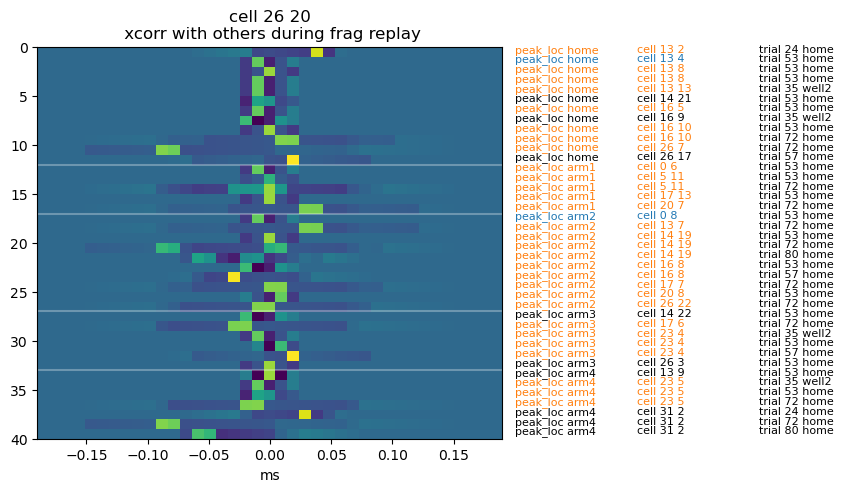

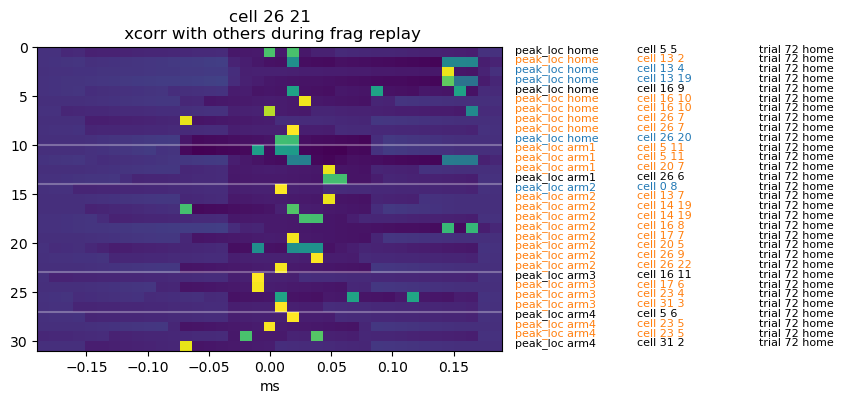

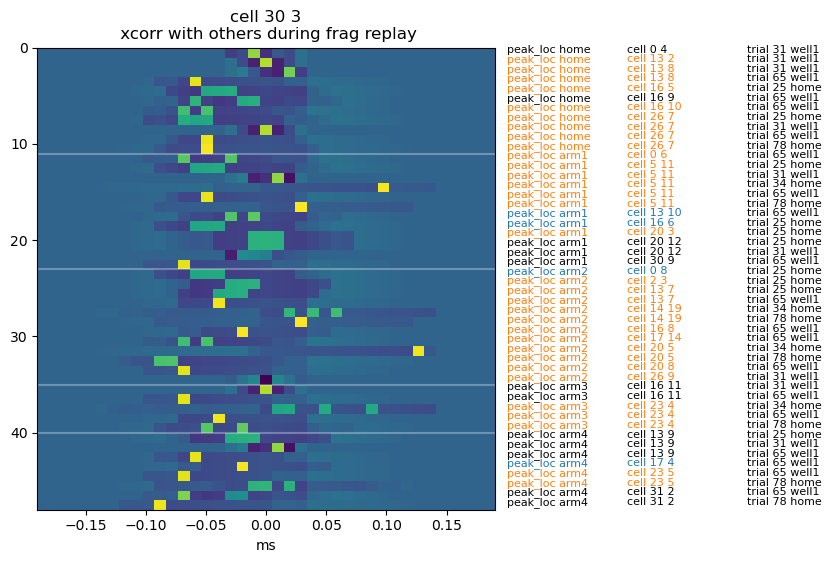

In [414]:
implicated_trials = []
for c_ind in range(len(cells_frag)):
    cell = cells_frag[c_ind]
    savename = session_name+'_'+str(cell[0])+str(cell[1])+'xcorr'
    
    firing_corr_frag_p, ripple_ind_frag_p, other_cell, other_cell_ind = find_xcorr_col_frag(cell,
                                                                                            cell_list,
                                                                                            pairs_frag,firing_corr_frag,ripple_ind_frag)
    col_ind_all,peak_loc_all = sort_by_peak(other_cell_ind)
    
    
    firing_corr_frag_p_arm = firing_corr_frag_p[:,col_ind_all] #sorted by arm
    ripple_ind_frag_p_arm = ripple_ind_frag_p[col_ind_all]
    other_cell_p_arm = other_cell[col_ind_all]

    implicated_trials.append([ripple_times.loc[r].trial_number for r in np.unique(ripple_ind_frag_p_arm)])
    
    fig, axes = plt.subplots(1, 1, figsize = (6,6))
    
    row_num = firing_corr_frag_p_arm.shape[1]
    axes.imshow(firing_corr_frag_p_arm.T, aspect = 0.008, extent = [lag_frag[0] * DELTA_T, lag_frag[-1] * DELTA_T,row_num,0]);
    axes.set_xlabel('ms')
    axes.set_title('cell '+str(cell[0]) + ' ' +str(cell[1]) +'\n xcorr with others during frag replay')
    
    diff_row = [r_ind for r_ind in range(1,len(peak_loc_all)) if peak_loc_all[r_ind] != peak_loc_all[r_ind-1]]
    
    for r_ind in range(len(ripple_ind_frag_p_arm)):
        entry = ripple_times.loc[ripple_ind_frag_p_arm[r_ind]]
        axes.text(0.4,r_ind+0.5,'trial '+str(entry.trial_number)+' '+entry.animal_location,fontsize = 8)
        if len(set([tuple(other_cell_p_arm[r_ind]),]).intersection(set(cells_cont))) > 0:
            color = 'C1'
        elif len(set([tuple(other_cell_p_arm[r_ind]),]).intersection(set(cells_frag))) > 0:
            color = 'C0'
        else:
            color = 'k'
        axes.text(0.3,r_ind+0.5,'cell '+str(other_cell_p_arm[r_ind][0])+' '+str(other_cell_p_arm[r_ind][1]), fontsize = 8, color = color)
        axes.text(0.2,r_ind+0.5,'peak_loc '+peak_loc_all[r_ind],fontsize = 8, color = color)
    
    for r_ind in diff_row:
        axes.axhline(r_ind, color = [1,1,1], alpha = 0.3)
    
    if len(outputFolder)>0:
        plt.savefig(os.path.join(outputFolder,savename+'.pdf'),format="pdf",bbox_inches='tight',dpi=200)

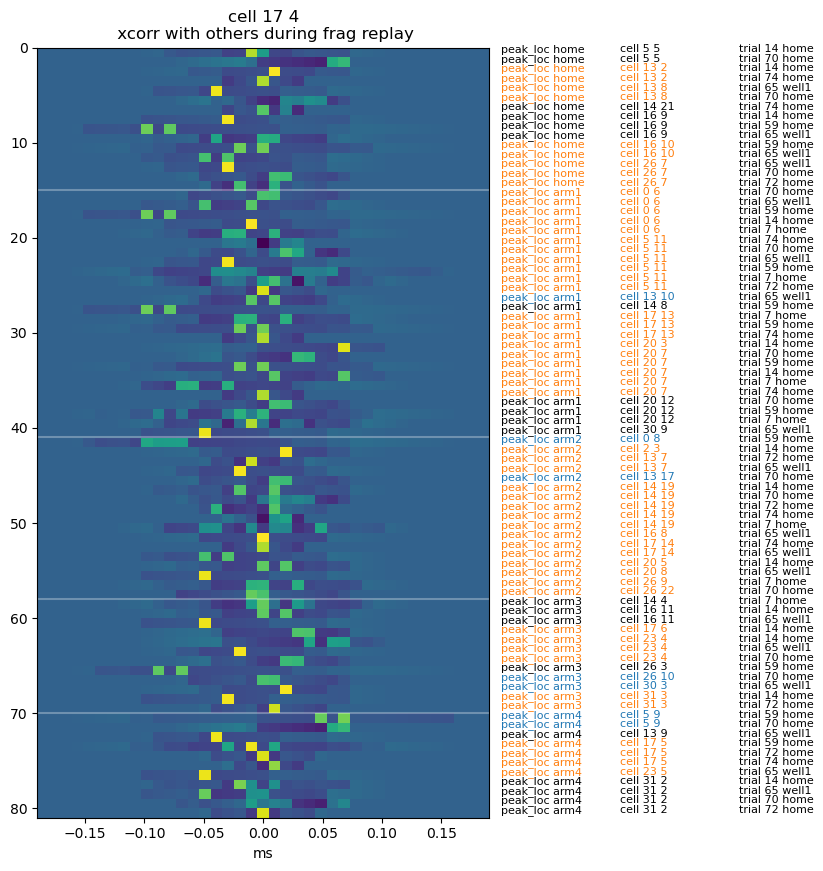

In [719]:
implicated_trials = []
cells_frag_ = [(17,4)]
for c_ind in range(len(cells_frag_)):

    cell = cells_frag_[c_ind]
    savename = session_name+'_'+str(cell[0])+str(cell[1])+'xcorr'
    
    firing_corr_frag_p, ripple_ind_frag_p, other_cell, other_cell_ind = find_xcorr_col_frag(cell,
                                                                                            cell_list,
                                                                                            pairs_frag,firing_corr_frag,ripple_ind_frag)
    col_ind_all,peak_loc_all = sort_by_peak(other_cell_ind)
    
    
    firing_corr_frag_p_arm = firing_corr_frag_p[:,col_ind_all] #sorted by arm
    ripple_ind_frag_p_arm = ripple_ind_frag_p[col_ind_all]
    other_cell_p_arm = other_cell[col_ind_all]

    implicated_trials.append([ripple_times.loc[r].trial_number for r in np.unique(ripple_ind_frag_p_arm)])
    
    fig, axes = plt.subplots(1, 1, figsize = (10,10))
    
    row_num = firing_corr_frag_p_arm.shape[1]
    axes.imshow(firing_corr_frag_p_arm.T, aspect = 0.008, extent = [lag_frag[0] * DELTA_T, lag_frag[-1] * DELTA_T,row_num,0]);
    axes.set_xlabel('ms')
    axes.set_title('cell '+str(cell[0]) + ' ' +str(cell[1]) +'\n xcorr with others during frag replay')
    
    diff_row = [r_ind for r_ind in range(1,len(peak_loc_all)) if peak_loc_all[r_ind] != peak_loc_all[r_ind-1]]
    
    for r_ind in range(len(ripple_ind_frag_p_arm)):
        entry = ripple_times.loc[ripple_ind_frag_p_arm[r_ind]]
        axes.text(0.4,r_ind+0.5,'trial '+str(entry.trial_number)+' '+entry.animal_location,fontsize = 8)
        if len(set([tuple(other_cell_p_arm[r_ind]),]).intersection(set(cells_cont))) > 0:
            color = 'C1'
        elif len(set([tuple(other_cell_p_arm[r_ind]),]).intersection(set(cells_frag))) > 0:
            color = 'C0'
        else:
            color = 'k'
        axes.text(0.3,r_ind+0.5,'cell '+str(other_cell_p_arm[r_ind][0])+' '+str(other_cell_p_arm[r_ind][1]), fontsize = 8, color = color)
        axes.text(0.2,r_ind+0.5,'peak_loc '+peak_loc_all[r_ind],fontsize = 8, color = color)
    
    for r_ind in diff_row:
        axes.axhline(r_ind, color = [1,1,1], alpha = 0.3)
    
    if len(outputFolder)>0:
        plt.savefig(os.path.join(outputFolder,savename+'.pdf'),format="pdf",bbox_inches='tight',dpi=200)

#### xcorr with others during continuous replays

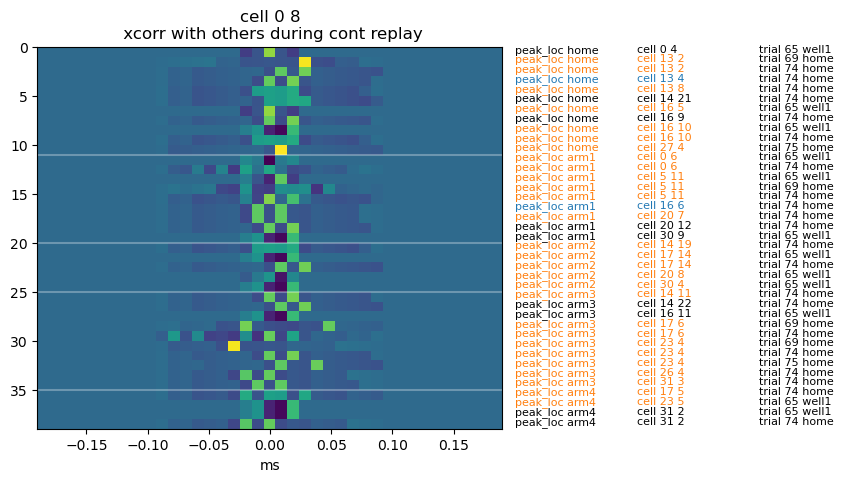

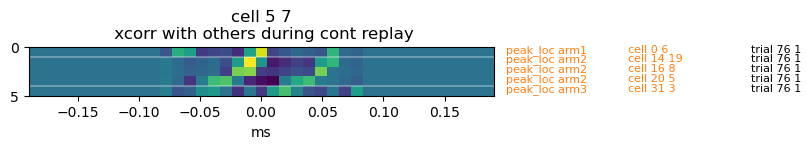

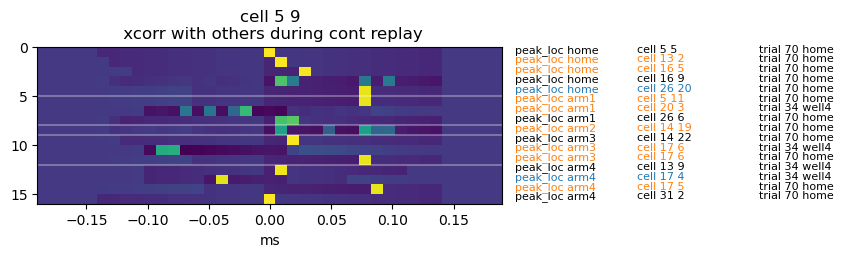

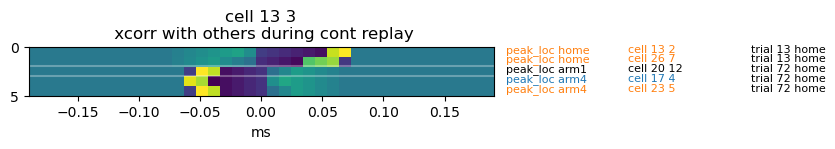

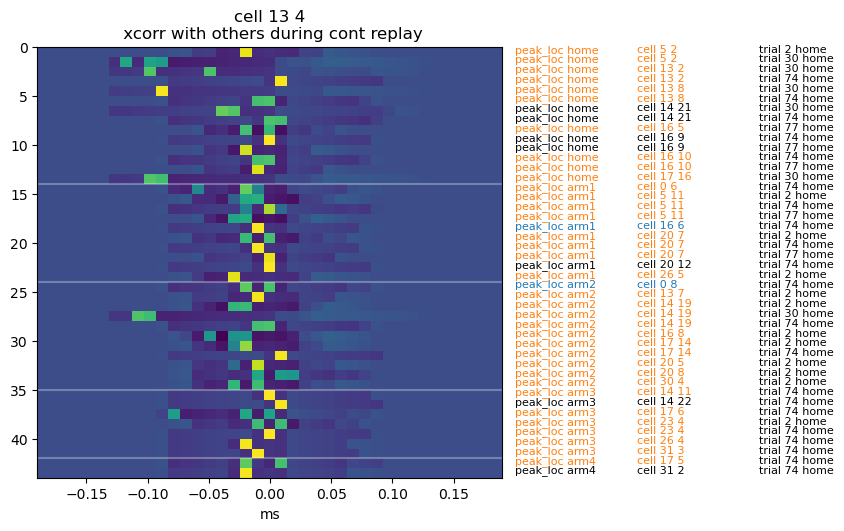

...

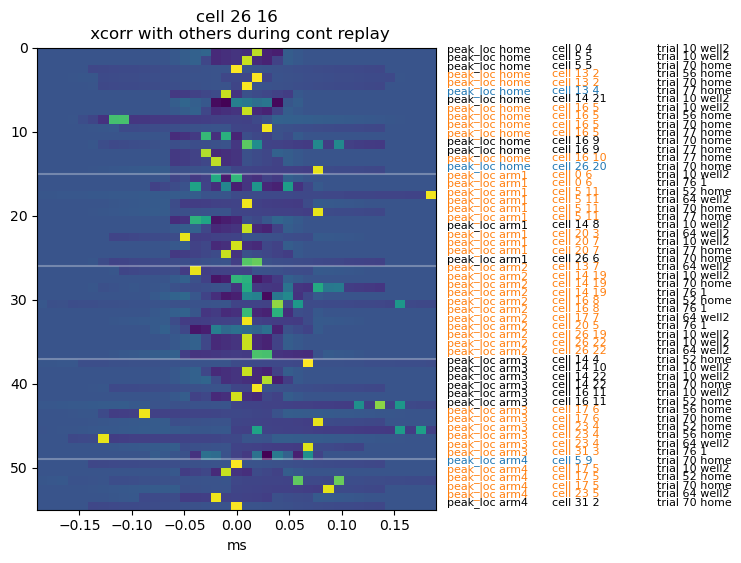

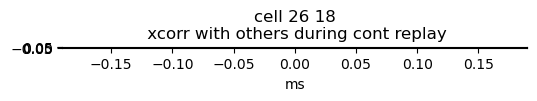

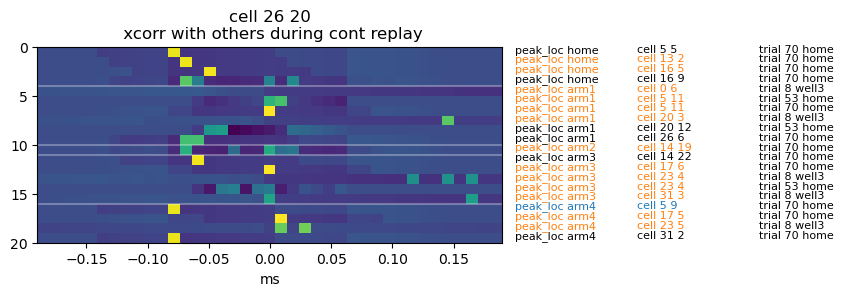

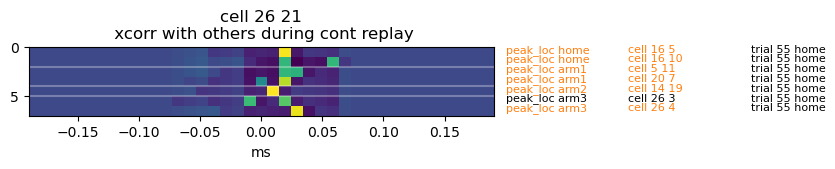

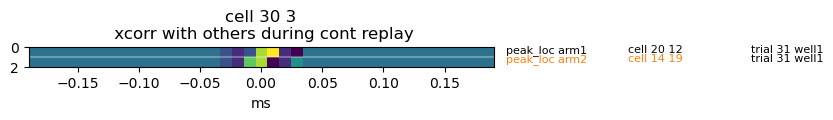

In [428]:
implicated_trials = []
for c_ind in range(len(cells_frag)):
    cell = cells_frag[c_ind]
    savename = session_name+'_'+str(cell[0])+str(cell[1])+'xcorr_cont'
    
    firing_corr_frag_p, ripple_ind_frag_p, other_cell, other_cell_ind = find_xcorr_col_frag(cell,
                                                                                            cell_list,
                                                                                            pairs_cont,firing_corr_cont,ripple_ind_cont)
    col_ind_all,peak_loc_all = sort_by_peak(other_cell_ind)
    
    
    firing_corr_frag_p_arm = firing_corr_frag_p[:,col_ind_all] #sorted by arm
    ripple_ind_frag_p_arm = ripple_ind_frag_p[col_ind_all]
    other_cell_p_arm = other_cell[col_ind_all]

    implicated_trials.append([ripple_times.loc[r].trial_number for r in np.unique(ripple_ind_frag_p_arm)])
    
    fig, axes = plt.subplots(1, 1, figsize = (6,6))
    
    row_num = firing_corr_frag_p_arm.shape[1]
    axes.imshow(firing_corr_frag_p_arm.T, aspect = 0.008, extent = [lag_frag[0] * DELTA_T, lag_frag[-1] * DELTA_T,row_num,0]);
    axes.set_xlabel('ms')
    axes.set_title('cell '+str(cell[0]) + ' ' +str(cell[1]) +'\n xcorr with others during cont replay')
    
    diff_row = [r_ind for r_ind in range(1,len(peak_loc_all)) if peak_loc_all[r_ind] != peak_loc_all[r_ind-1]]
    
    for r_ind in range(len(ripple_ind_frag_p_arm)):
        entry = ripple_times.loc[ripple_ind_frag_p_arm[r_ind]]
        axes.text(0.4,r_ind+0.5,'trial '+str(entry.trial_number)+' '+entry.animal_location,fontsize = 8)
        if len(set([tuple(other_cell_p_arm[r_ind]),]).intersection(set(cells_cont))) > 0:
            color = 'C1'
        elif len(set([tuple(other_cell_p_arm[r_ind]),]).intersection(set(cells_frag))) > 0:
            color = 'C0'
        else:
            color = 'k'
        axes.text(0.3,r_ind+0.5,'cell '+str(other_cell_p_arm[r_ind][0])+' '+str(other_cell_p_arm[r_ind][1]), fontsize = 8, color = color)
        axes.text(0.2,r_ind+0.5,'peak_loc '+peak_loc_all[r_ind],fontsize = 8, color = color)
    
    for r_ind in diff_row:
        axes.axhline(r_ind, color = [1,1,1], alpha = 0.3)
    
    if len(outputFolder)>0:
        plt.savefig(os.path.join(outputFolder,savename+'.pdf'),format="pdf",bbox_inches='tight',dpi=200)

In [436]:
ripple_times.loc[148:]

,start_time,end_time,animal_location,trial_number,cont_intvl,frag_intvl,cont_intvl_replay,duration,mean_zscore,median_zscore,max_zscore,min_zscore,speed_at_start,speed_at_end,max_speed,min_speed,median_speed,mean_speed
148,1.666479e+09,1.666479e+09,home,69,"[[1666478674.491042, 1666478674.5890422]]",[],[[3]],0.100000,2.001299,2.215455,3.360292,0.019815,0.181491,0.181493,0.181493,0.181491,0.181492,0.181492
149,1.666479e+09,1.666479e+09,home,69,"[[1666478677.297042, 1666478677.365042]]",[],[[0]],0.070000,1.870409,1.068589,5.388461,-0.234166,3.900844,3.975903,3.975903,3.900844,3.920893,3.924492
150,1.666479e+09,1.666479e+09,home,70,"[[1666478696.6750395, 1666478696.8170395], [16...","[[1666478696.819039, 1666478696.8970394]]","[[], [2]]",0.278000,7.273714,5.161727,25.230742,-0.755223,0.855875,0.606341,0.855875,0.606341,0.760650,0.756047
151,1.666479e+09,1.666479e+09,well1,70,"[[1666478705.3930385, 1666478705.5590384]]",[],[[4]],0.168000,1.387967,1.114789,3.680337,0.022937,0.557607,1.766443,1.808368,0.557607,1.507954,1.388426
152,1.666479e+09,1.666479e+09,home,71,"[[1666478715.1610372, 1666478715.2490373]]","[[1666478715.2510371, 1666478715.3330371]]",[[3]],0.175000,1.253105,1.242114,2.853679,0.052174,2.022081,2.022078,2.022082,2.022074,2.022077,2.022078
153,1.666479e+09,1.666479e+09,well2,71,"[[1666478723.669036, 1666478723.7010362]]",[],[[2]],0.033000,2.272251,2.549341,3.384493,0.107088,3.997854,3.760712,3.997854,3.760712,3.913257,3.903736
154,1.666479e+09,1.666479e+09,home,72,"[[1666478742.411034, 1666478742.4510338], [166...","[[1666478742.4530337, 1666478742.6030338], [16...","[[], [], []]",0.312000,4.557810,2.820294,15.142686,-0.784857,0.228554,0.172179,0.228554,0.171863,0.172174,0.176935
155,1.666479e+09,1.666479e+09,home,72,[],"[[1666478742.9990337, 1666478743.1310337]]",[],0.172000,4.421417,2.328642,14.067582,-0.766439,0.172182,0.172182,0.172183,0.172182,0.172183,0.172183
156,1.666479e+09,1.666479e+09,home,72,"[[1666478743.6790335, 1666478743.7490337]]","[[1666478743.7510335, 1666478743.9570336]]",[[0]],0.295000,4.503607,2.717588,22.160954,-0.713404,0.868088,2.938392,2.938392,0.868088,2.338144,2.170612
157,1.666479e+09,1.666479e+09,home,72,"[[1666478744.2750337, 1666478744.3430336]]","[[1666478744.3450336, 1666478744.4090335]]",[[3]],0.136000,1.791754,1.529701,3.964513,-0.355976,2.982183,2.982190,2.982190,2.982178,2.982182,2.982183


#### It looks like only a small subset of trials have these fragmented ripples, but that is not true.
Fragmented replays occur throughout the session

In [413]:
trials_frag = []
for r in np.unique(ripple_ind_frag):
    trials_frag.append(ripple_times.loc[r].trial_number)
trials_frag = np.unique(trials_frag)
print(trials_frag)

[ 2  6  7 10 11 12 14 16 24 25 26 29 31 32 34 35 36 40 43 45 53 55 57 59
 62 64 65 70 71 72 74 75 78 80 81]


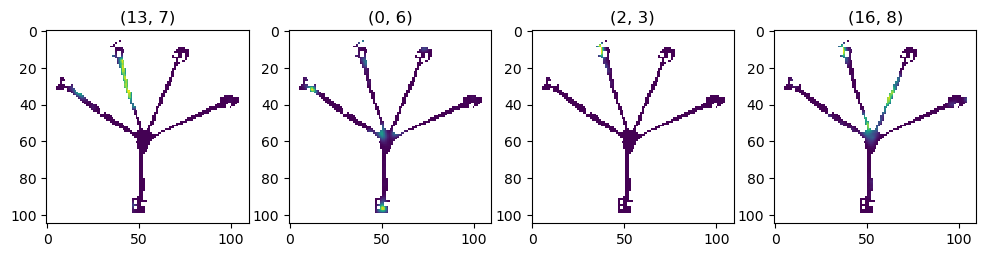

In [717]:
# trial 43
pairs = [(26,20)]
fig, axes = plt.subplots(1,int(np.ceil(len(pairs))), figsize = (12,5), squeeze = True)

ind = 0
for p in pairs:
    (e,u) = p
    axes[np.unravel_index(ind, axes.shape)].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    axes[np.unravel_index(ind, axes.shape)].text(100,60,all_spike_counts[(e,u)])
    ind = ind + 1

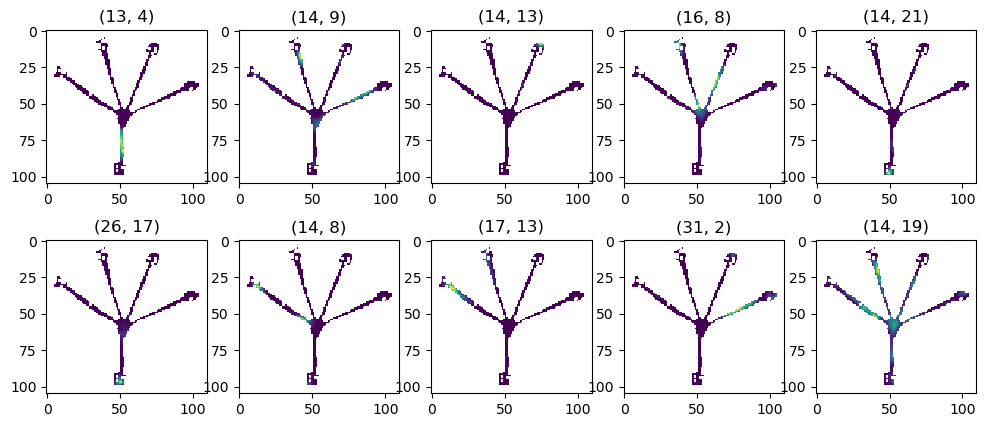

In [712]:
# trial 6
pairs = [(13,4),(14,9),(14,13),(16,8),(14,21),(26,17),(14,8),(17,13),(31,2),(14,19)]
fig, axes = plt.subplots(2,int(np.ceil(len(pairs)/2)), figsize = (12,5), squeeze = True)

ind = 0
for p in pairs:
    (e,u) = p
    axes[np.unravel_index(ind, axes.shape)].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    ind = ind + 1

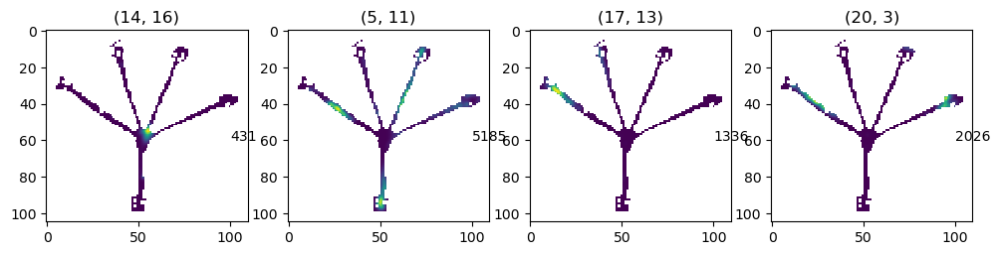

In [722]:
# trial 45
pairs = [(14,16),(5,11),(17,13),(20,3)]
fig, axes = plt.subplots(1,len(pairs), figsize = (12,3))

ind = 0
for p in pairs:
    (e,u) = p
    axes[ind].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    axes[np.unravel_index(ind, axes.shape)].text(100,60,all_spike_counts[(e,u)])
    ind = ind + 1

In [ ]:
# trial 72
pairs = [(13,2),(0,6),(14,8),(0,8),(26,3)]
fig, axes = plt.subplots(1,len(pairs), figsize = (12,3))

ind = 0
for p in pairs:
    (e,u) = p
    axes[ind].imshow(placefields[(e,u)])
    ind = ind + 1

In [ ]:
# trial 35 -frag
pairs = [(26,16),(16,9),(13,13),(23,4),(23,5),(26,20)]
fig, axes = plt.subplots(2,int(np.ceil(len(pairs)/2)), figsize = (12,5), squeeze = True)

ind = 0
for p in pairs:
    (e,u) = p
    axes[np.unravel_index(ind, axes.shape)].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    ind = ind + 1

In [ ]:
# trial 29 -frag
pairs = [(5,9),(26,10),(16,5),(16,6),(20,3),(14,19),(17,9)]
fig, axes = plt.subplots(2,int(np.ceil(len(pairs)/2)), figsize = (12,5), squeeze = True)

ind = 0
for p in pairs:
    (e,u) = p
    axes[np.unravel_index(ind, axes.shape)].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    ind = ind + 1

In [ ]:
# trial 31 -frag
pairs = [(30,3),(0,4),(13,2),(26,7),(16,11),(5,11),(13,9),(13,8)]
fig, axes = plt.subplots(2,int(np.ceil(len(pairs)/2)), figsize = (12,5), squeeze = True)

ind = 0
for p in pairs:
    (e,u) = p
    axes[np.unravel_index(ind, axes.shape)].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    ind = ind + 1

In [ ]:
# trial 70 -frag
pairs = [(13,17),(26,7),(0,6),(5,11),(20,12),(26,22),(20,7),(23,4),(26,10),(17,4)]
fig, axes = plt.subplots(2,int(np.ceil(len(pairs)/2)), figsize = (12,5), squeeze = True)

ind = 0
for p in pairs:
    (e,u) = p
    axes[np.unravel_index(ind, axes.shape)].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    ind = ind + 1

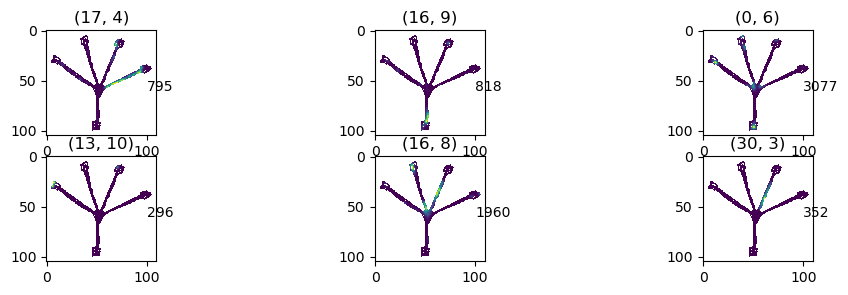

In [721]:
# trial 65 -frag
pairs = [(17,4),(16,9),(0,6),(13,10),(16,8),(30,3)]
fig, axes = plt.subplots(2,int(np.ceil(len(pairs)/2)), figsize = (12,3), squeeze = True)

ind = 0
for p in pairs:
    (e,u) = p
    axes[np.unravel_index(ind, axes.shape)].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    axes[np.unravel_index(ind, axes.shape)].text(100,60,all_spike_counts[(e,u)])
    ind = ind + 1

In [ ]:
# trial 64 -frag
pairs = [(13,17),(16,5),(16,9),(20,7),(2,3),(14,19),(16,11),(5,9)]
fig, axes = plt.subplots(2,int(np.ceil(len(pairs)/2)), figsize = (12,3), squeeze = True)

ind = 0
for p in pairs:
    (e,u) = p
    axes[np.unravel_index(ind, axes.shape)].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    ind = ind + 1

In [ ]:
# trial 64 - cont
pairs = [(13,17),(13,8),(20,7),(23,5),(16,5)]
fig, axes = plt.subplots(1,len(pairs), figsize = (12,3))

ind = 0
for p in pairs:
    (e,u) = p
    axes[ind].imshow(placefields[(e,u)])
    axes[ind].set_title(p)
    ind = ind + 1

#### continuous cells

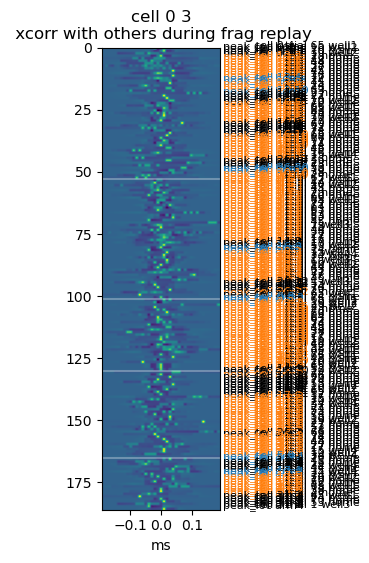

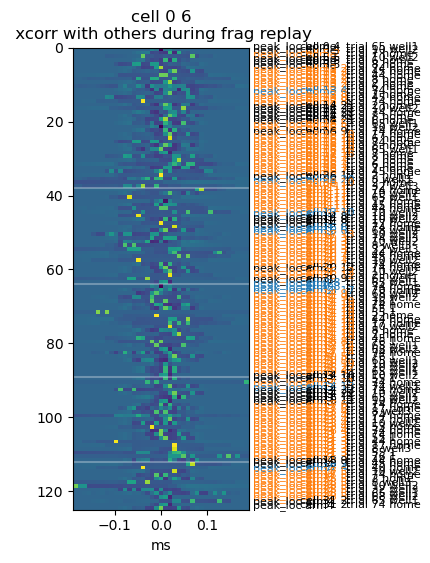

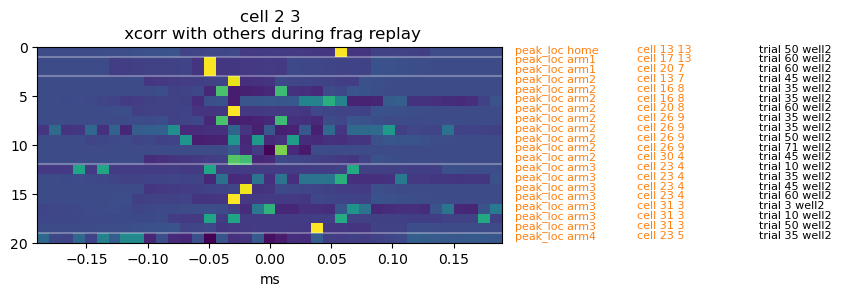

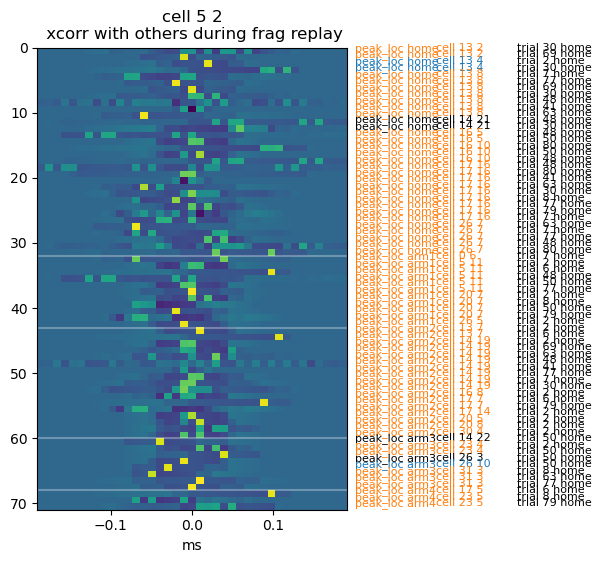

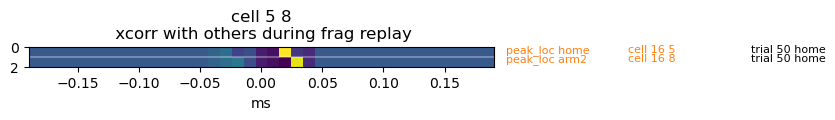

...

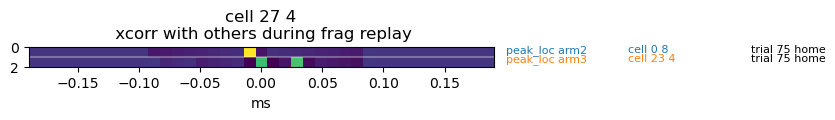

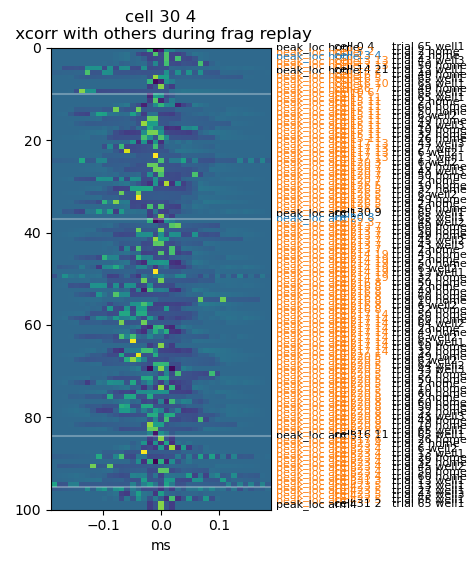

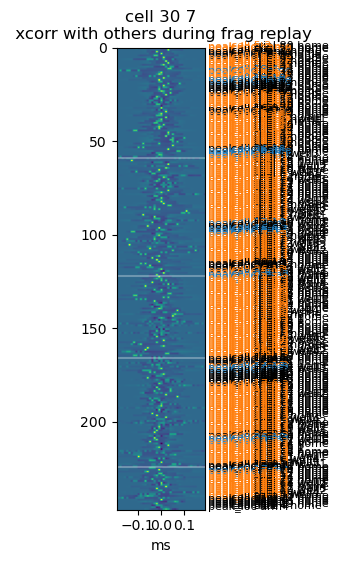

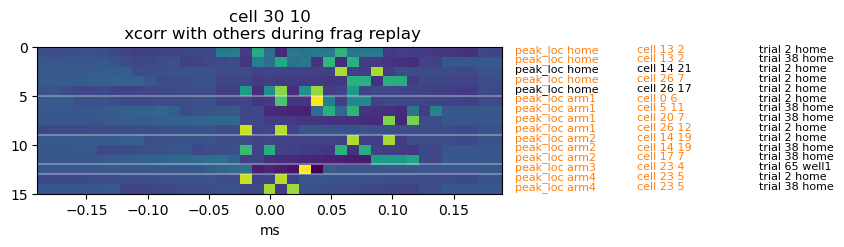

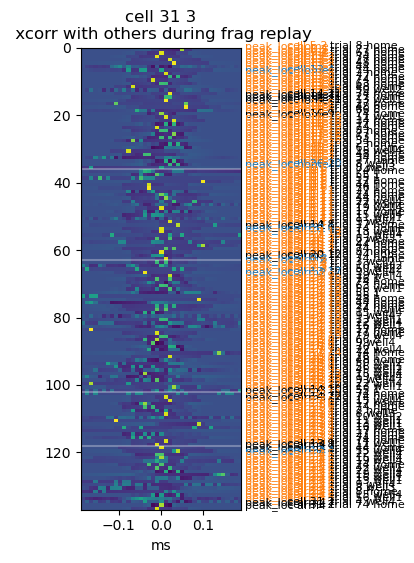

In [723]:
implicated_trials = []
for c_ind in range(len(cells_cont)):
    cell = cells_cont[c_ind]
    savename = session_name+'_'+str(cell[0])+str(cell[1])+'xcorr_cont'
    
    firing_corr_cont_p, ripple_ind_cont_p, other_cell, other_cell_ind = find_xcorr_col_frag(cell,
                                                                                            cell_list,
                                                                                            pairs_cont,firing_corr_cont,ripple_ind_cont)
    col_ind_all,peak_loc_all = sort_by_peak(other_cell_ind)
    
    
    firing_corr_cont_p_arm = firing_corr_cont_p[:,col_ind_all] #sorted by arm
    ripple_ind_cont_p_arm = ripple_ind_cont_p[col_ind_all]
    other_cell_p_arm = other_cell[col_ind_all]

    implicated_trials.append([ripple_times.loc[r].trial_number for r in np.unique(ripple_ind_cont_p_arm)])
    
    fig, axes = plt.subplots(1, 1, figsize = (6,6))
    
    row_num = firing_corr_cont_p_arm.shape[1]
    axes.imshow(firing_corr_cont_p_arm.T, aspect = 0.008, extent = [lag_cont[0] * DELTA_T, lag_cont[-1] * DELTA_T,row_num,0]);
    axes.set_xlabel('ms')
    axes.set_title('cell '+str(cell[0]) + ' ' +str(cell[1]) +'\n xcorr with others during frag replay')
    
    diff_row = [r_ind for r_ind in range(1,len(peak_loc_all)) if peak_loc_all[r_ind] != peak_loc_all[r_ind-1]]
    
    for r_ind in range(len(ripple_ind_cont_p_arm)):
        entry = ripple_times.loc[ripple_ind_cont_p_arm[r_ind]]
        axes.text(0.4,r_ind+0.5,'trial '+str(entry.trial_number)+' '+entry.animal_location,fontsize = 8)
        if len(set([tuple(other_cell_p_arm[r_ind]),]).intersection(set(cells_cont))) > 0:
            color = 'C1'
        elif len(set([tuple(other_cell_p_arm[r_ind]),]).intersection(set(cells_frag))) > 0:
            color = 'C0'
        else:
            color = 'k'
        axes.text(0.3,r_ind+0.5,'cell '+str(other_cell_p_arm[r_ind][0])+' '+str(other_cell_p_arm[r_ind][1]), fontsize = 8, color = color)
        axes.text(0.2,r_ind+0.5,'peak_loc '+peak_loc_all[r_ind],fontsize = 8, color = color)
    
    for r_ind in diff_row:
        axes.axhline(r_ind, color = [1,1,1], alpha = 0.3)
    
    if len(outputFolder)>0:
        plt.savefig(os.path.join(outputFolder,savename+'.pdf'),format="pdf",bbox_inches='tight',dpi=200)

In [825]:
cell_list_by_arm['arm2']

array([[ 0,  8],
       [ 2,  3],
       [13,  7],
       [13, 14],
       [13, 15],
       [13, 16],
       [13, 17],
       [14,  9],
       [14, 19],
       [14, 20],
       [16,  8],
       [17,  7],
       [17,  9],
       [17, 14],
       [20,  5],
       [20,  8],
       [26,  9],
       [26, 19],
       [26, 22],
       [30,  4]])

In [826]:
e = 13
u = 7
firing_rate_F[e][u][1]/firing_rate_C[e][u][1]

0.4444444444444444

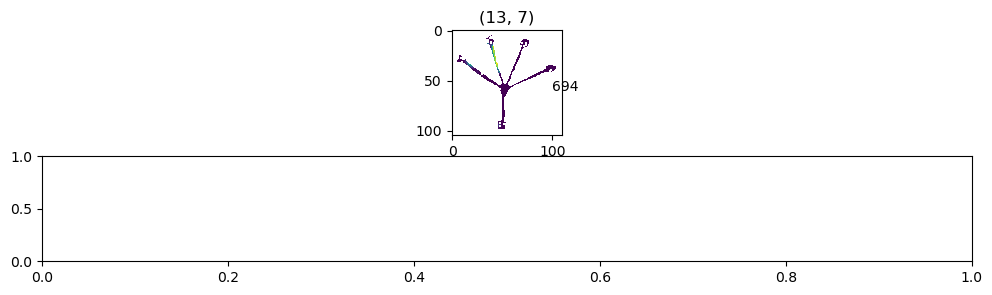

In [827]:
# trial 49 - cont
pairs = [(13,7)]
fig, axes = plt.subplots(2,int(np.ceil(len(pairs)/2)), figsize = (12,3), squeeze = True)

ind = 0
for p in pairs:
    (e,u) = p
    axes[np.unravel_index(ind, axes.shape)].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    axes[np.unravel_index(ind, axes.shape)].text(100,60,all_spike_counts[(e,u)])
    ind = ind + 1

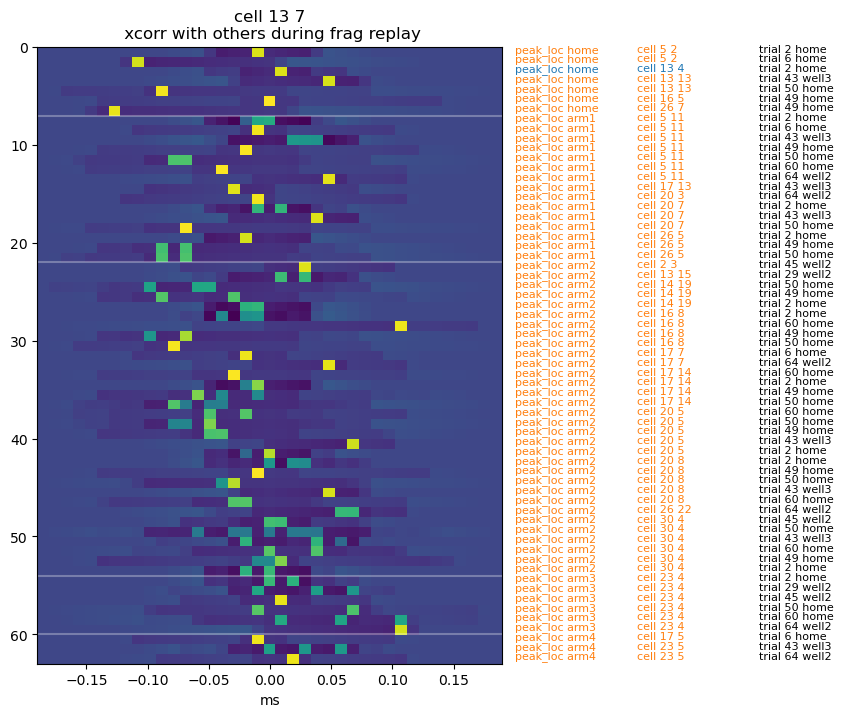

In [828]:
implicated_trials = []
cells_cont_ = [(13,7)]
for c_ind in range(len(cells_cont_)):
    cell = cells_cont_[c_ind]
    savename = session_name+'_'+str(cell[0])+str(cell[1])+'xcorr_cont'
    
    firing_corr_cont_p, ripple_ind_cont_p, other_cell, other_cell_ind = find_xcorr_col_frag(cell,
                                                                                            cell_list,
                                                                                            pairs_cont,firing_corr_cont,ripple_ind_cont)
    col_ind_all,peak_loc_all = sort_by_peak(other_cell_ind)
    
    
    firing_corr_cont_p_arm = firing_corr_cont_p[:,col_ind_all] #sorted by arm
    ripple_ind_cont_p_arm = ripple_ind_cont_p[col_ind_all]
    other_cell_p_arm = other_cell[col_ind_all]

    implicated_trials.append([ripple_times.loc[r].trial_number for r in np.unique(ripple_ind_cont_p_arm)])
    
    fig, axes = plt.subplots(1, 1, figsize = (6,10))
    
    row_num = firing_corr_cont_p_arm.shape[1]
    axes.imshow(firing_corr_cont_p_arm.T, aspect = 0.008, extent = [lag_cont[0] * DELTA_T, lag_cont[-1] * DELTA_T,row_num,0]);
    axes.set_xlabel('ms')
    axes.set_title('cell '+str(cell[0]) + ' ' +str(cell[1]) +'\n xcorr with others during frag replay')
    
    diff_row = [r_ind for r_ind in range(1,len(peak_loc_all)) if peak_loc_all[r_ind] != peak_loc_all[r_ind-1]]
    
    for r_ind in range(len(ripple_ind_cont_p_arm)):
        entry = ripple_times.loc[ripple_ind_cont_p_arm[r_ind]]
        axes.text(0.4,r_ind+0.5,'trial '+str(entry.trial_number)+' '+entry.animal_location,fontsize = 8)
        if len(set([tuple(other_cell_p_arm[r_ind]),]).intersection(set(cells_cont))) > 0:
            color = 'C1'
        elif len(set([tuple(other_cell_p_arm[r_ind]),]).intersection(set(cells_frag))) > 0:
            color = 'C0'
        else:
            color = 'k'
        axes.text(0.3,r_ind+0.5,'cell '+str(other_cell_p_arm[r_ind][0])+' '+str(other_cell_p_arm[r_ind][1]), fontsize = 8, color = color)
        axes.text(0.2,r_ind+0.5,'peak_loc '+peak_loc_all[r_ind],fontsize = 8, color = color)
    
    for r_ind in diff_row:
        axes.axhline(r_ind, color = [1,1,1], alpha = 0.3)
    
    if len(outputFolder)>0:
        plt.savefig(os.path.join(outputFolder,savename+'.pdf'),format="pdf",bbox_inches='tight',dpi=200)

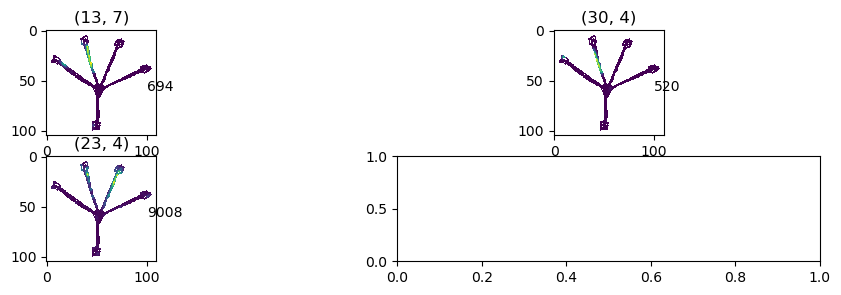

In [833]:
# trial 50, cont
pairs = [(13,7),(30,4),(23,4)]
fig, axes = plt.subplots(2,int(np.ceil(len(pairs)/2)), figsize = (12,3), squeeze = True)

ind = 0
for p in pairs:
    (e,u) = p
    axes[np.unravel_index(ind, axes.shape)].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    axes[np.unravel_index(ind, axes.shape)].text(100,60,all_spike_counts[(e,u)])
    ind = ind + 1

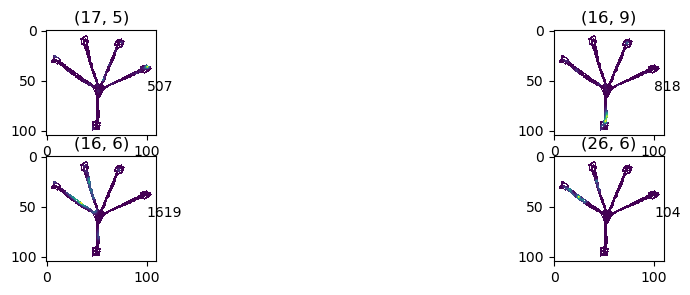

In [813]:
# trial 49, cont
pairs = [(17,5),(16,9),(16,6),(26,6),()]
fig, axes = plt.subplots(2,int(np.ceil(len(pairs)/2)), figsize = (12,3), squeeze = True)

ind = 0
for p in pairs:
    (e,u) = p
    axes[np.unravel_index(ind, axes.shape)].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    axes[np.unravel_index(ind, axes.shape)].text(100,60,all_spike_counts[(e,u)])
    ind = ind + 1

## B. Use xcorr to find cliques of cells

In [702]:
import networkx as nx

G = nx.Graph()  # or DiGraph, MultiGraph, MultiDiGraph, etc


cell_list_ = cells_cont#cells_frag #cell_list#[(13,17),(30,3)]#cells_frag
cell0_list = {} # this is for plotting
cell1_list = {} # this is for plotting

for c0_ind in range(len(cell_list_)):
    cell = cell_list_[c0_ind]
    cell0_ind = np.argwhere(np.sum(np.array(cell_list) == np.array(cell), axis = 1) == 2).ravel()[0]
    
    savename = session_name+'_'+str(cell[0])+str(cell[1])+'xcorr'
    
    firing_corr_frag_p, ripple_ind_frag_p, other_cell, other_cell_ind = find_xcorr_col_frag(cell,
                                                                                            cell_list,
                                                                                            pairs_frag,firing_corr_frag,ripple_ind_frag)
    ind_center = np.argwhere(lag_frag == 0).ravel()[0]
    xcorr_center = firing_corr_frag_p.T[:,ind_center]
    xcorr_thresh = np.mean(xcorr_center) + 2*np.std(xcorr_center)
    cell1_ind = other_cell_ind[xcorr_center >= xcorr_thresh]
    if len(cell1_ind) > 0:
        cell_name = np.array(cell_list)[cell0_ind]
        label = str(cell_name[0])+' '+str(cell_name[1])
        G.add_nodes_from([(cell0_ind, {"color": "blue"})])
        cell0_list[cell0_ind] = label

    for c1_ind in cell1_ind:
        #edges[c1_ind] = cell0_ind
        #disjoint_set.merge(cell0_ind,c1_ind)
        cell_name = np.array(cell_list)[c1_ind]
        label = str(cell_name[0])+' '+str(cell_name[1])
        G.add_nodes_from([(c1_ind, {"color": "orange"})])
        G.add_edge(cell0_ind,c1_ind)
        cell1_list[c1_ind] = label
        

In [661]:
cell_clique = [np.array(cell_list)[i] for i in [5, 13, 24, 26, 41, 44, 46, 62, 69, 74, 82, 85]]

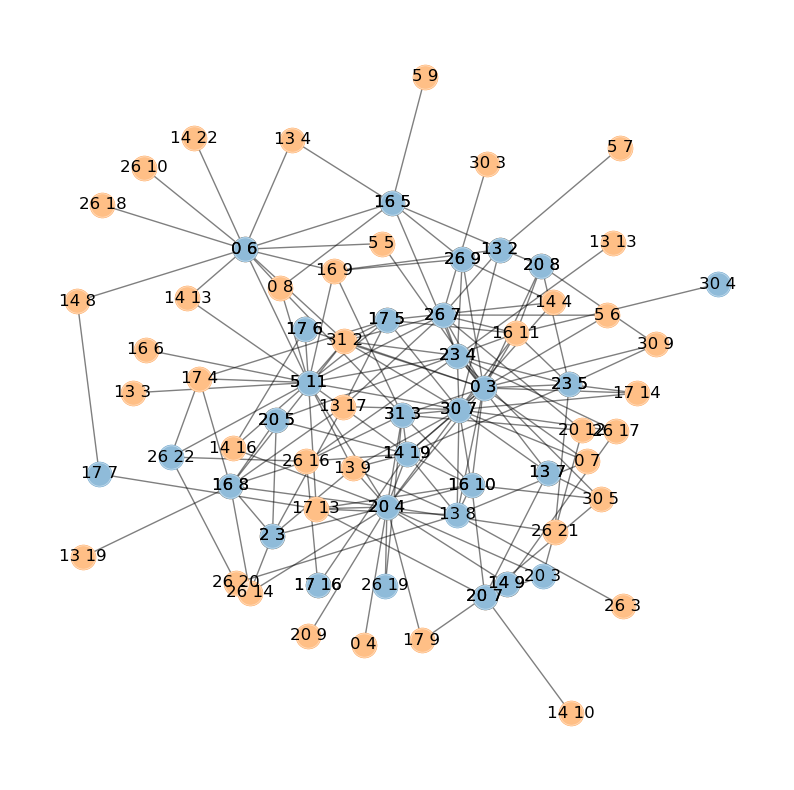

In [703]:
#pos = nx.spring_layout(G)  # positions for all nodes
fig, axes = plt.subplots(1,1, figsize = (10,10))

pos = nx.kamada_kawai_layout(G)
#pos = nx.bfs_layout(G)

nx.draw_networkx_nodes(G, pos, nodelist=cell1_list.keys(), node_color="tab:orange") #the order of plotting matters here
nx.draw_networkx_nodes(G, pos, nodelist=cell0_list.keys(), node_color="tab:blue")

#nx.draw(G, pos, with_labels=True, font_weight='bold')
nx.draw(G, pos, with_labels=False, alpha = 0.5, node_color="white")
nx.draw_networkx_labels(G,pos,cell0_list);
nx.draw_networkx_labels(G,pos,cell1_list);

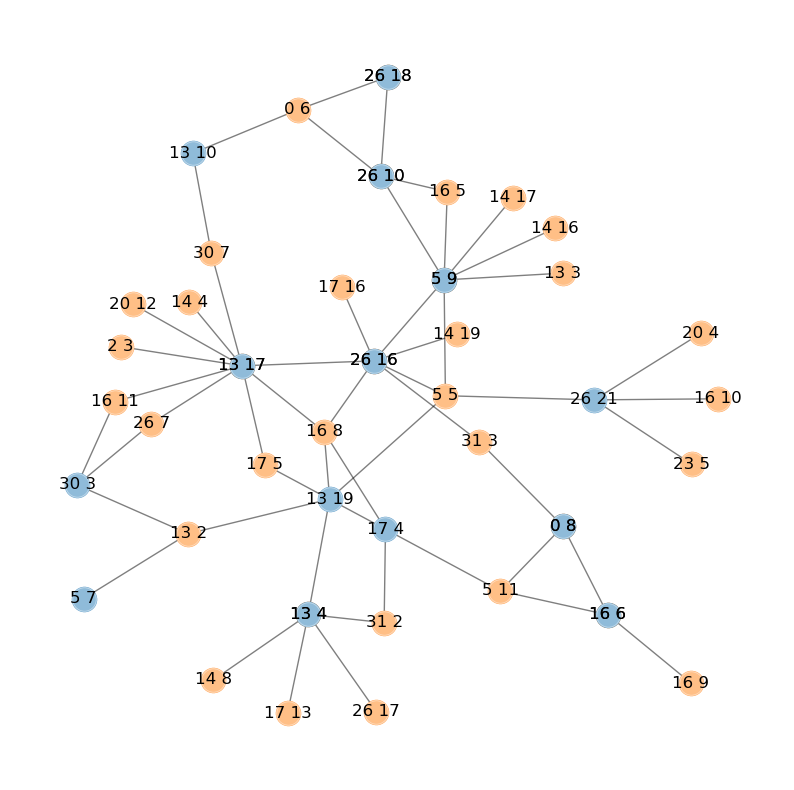

In [701]:
#pos = nx.spring_layout(G)  # positions for all nodes
fig, axes = plt.subplots(1,1, figsize = (10,10))

pos = nx.kamada_kawai_layout(G)
#pos = nx.bfs_layout(G)

nx.draw_networkx_nodes(G, pos, nodelist=cell1_list.keys(), node_color="tab:orange") #the order of plotting matters here
nx.draw_networkx_nodes(G, pos, nodelist=cell0_list.keys(), node_color="tab:blue")

#nx.draw(G, pos, with_labels=True, font_weight='bold')
nx.draw(G, pos, with_labels=False, alpha = 0.5, node_color="white")
nx.draw_networkx_labels(G,pos,cell0_list);
nx.draw_networkx_labels(G,pos,cell1_list);

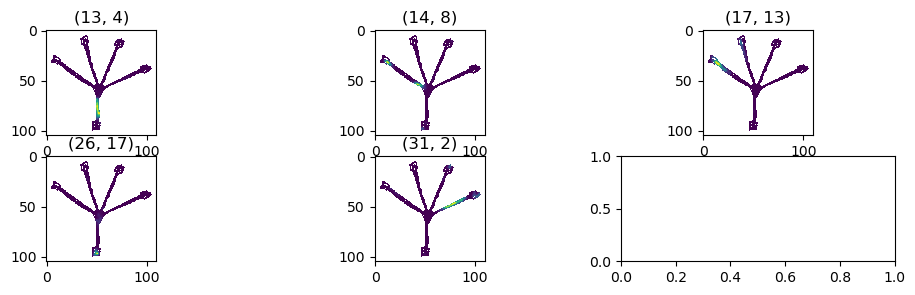

In [682]:
cell_clique = [(13,4),(14,8),(17,13),(26,17),(31,2)]
fig, axes = plt.subplots(2,int(np.ceil(len(cell_clique)/2)), figsize = (12,3), squeeze = True)

ind = 0
for p in cell_clique:
    (e,u) = p
    axes[np.unravel_index(ind, axes.shape)].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    ind = ind + 1

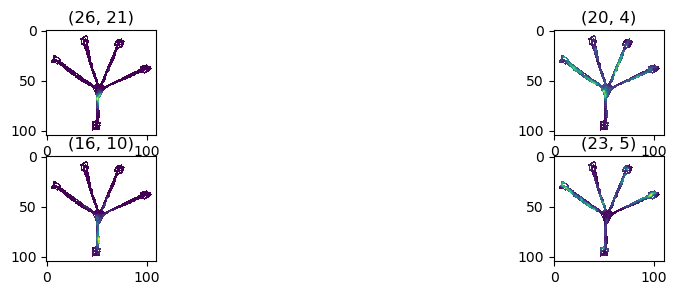

In [678]:
cell_clique = [(26,21),(20,4),(16,10),(23,5)]
fig, axes = plt.subplots(2,int(np.ceil(len(cell_clique)/2)), figsize = (12,3), squeeze = True)

ind = 0
for p in cell_clique:
    (e,u) = p
    axes[np.unravel_index(ind, axes.shape)].imshow(placefields[(e,u)])
    axes[np.unravel_index(ind, axes.shape)].set_title(p)
    ind = ind + 1

## C. placefield

In [254]:
import scipy.stats as stats


In [271]:
peak1ds = {}
peak1ds_list = []
entropys = {}
entropys_list = []
maxs = {}
maxs_list = []


for row_ind in range(len(cell_list)):
    print(row_ind)
    e = cell_list[row_ind][0]
    u = cell_list[row_ind][1]
    peak1d = placefield_to_peak1dloc('4 arm lumped 2023', placefields[(e,u)], ybins, xbins)
    peak1ds[(e,u)] = peak1d
    peak1ds_list.append(peak1d)

    placefield_ = placefields[(e,u)][~np.isnan(placefields[(e,u)])]
    p = placefield_.reshape((-1,1))
    entropy = stats.entropy(p,nan_policy='omit')
    entropys[(e,u)] = float(entropy)
    entropys_list.append(entropy)

    max = np.max(placefield_)
    maxs[(e,u)] = max
    maxs_list.append(max)
    

[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: 

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16


[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: 

17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33


[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:18][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: 

34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50


[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: 

51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67


[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: 

68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84


[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[08:19:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


85
86
87
88
89


In [279]:
# plot by groups
stats_frag = {}
peak1ds_frag = []
entropys_frag = []
maxs_frag = []

for cell_frag in cells_frag:
    peak1ds_frag.append(peak1ds[cell_frag])
    entropys_frag.append(entropys[cell_frag])
    maxs_frag.append(maxs[cell_frag])
stats_frag['peak_location'] = peak1ds_frag
stats_frag['entropy'] = entropys_frag
stats_frag['max_firing'] = maxs_frag

stats_cont = {}
peak1ds_cont = []
entropys_cont = []
maxs_cont = []
for cell_cont in cells_cont:
    peak1ds_cont.append(peak1ds[cell_cont])
    entropys_cont.append(entropys[cell_cont])
    maxs_cont.append(maxs[cell_cont])
stats_cont['peak_location'] = peak1ds_cont
stats_cont['entropy'] = entropys_cont
stats_cont['max_firing'] = maxs_cont

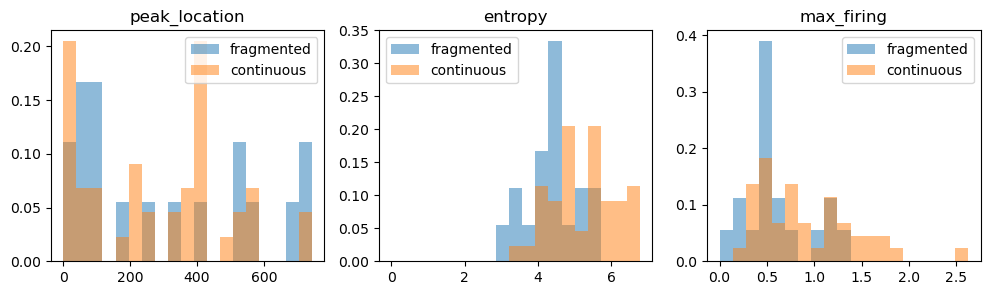

In [280]:
fig, axes = plt.subplots(1, 3, figsize = (12,3))

ind = 0
for stats in ['peak_location','entropy','max_firing']:
    data1 = stats_frag[stats]
    data2 = stats_cont[stats]
    max = np.max([np.max(data1),np.max(data2)])
    
    axes[ind].hist(data1,bins = np.linspace(0,max,20),alpha = 0.5,
            weights = np.ones(len(data1))/(len(data1)),label = 'fragmented')
    
    
    axes[ind].hist(data2,bins = np.linspace(0,max,20),alpha = 0.5,
            weights = np.ones(len(data2))/(len(data2)),label = 'continuous')

    axes[ind].set_title(stats,fontsize = 12)
    axes[ind].legend()
    ind = ind + 1

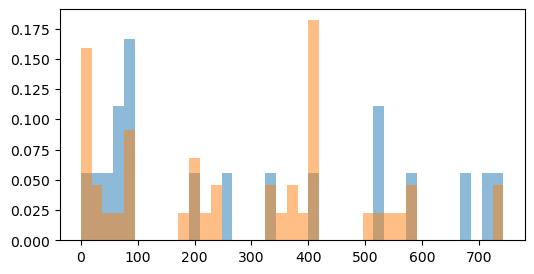

In [443]:
fig, axes = plt.subplots(1, 1, figsize = (6,3))

ind = 0
stats = 'peak_location'
data1 = stats_frag[stats]
data2 = stats_cont[stats]
max = np.max([np.max(data1),np.max(data2)])
    
axes.hist(data1,bins = np.linspace(0,max,40),alpha = 0.5,
               weights = np.ones(len(data1))/(len(data1)),label = 'fragmented');
axes.hist(data2,bins = np.linspace(0,max,40),alpha = 0.5,
               weights = np.ones(len(data2))/(len(data2)),label = 'continuous');
    

In [ ]:
firing_matrix = find_spikes(nwb_units_all,cell_list,axis)

In [ ]:
fig, axes = plt.subplots(len(cells_frag),4,figsize = (15,5*len(cells_frag)),sharex = 1)

row_ind = 0
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    nwb_units,extractor = findWaveForms(nwb_copy_file_name,session_name,e)
    waveforms = extractor.get_waveforms(u)

    # continuous time waveforms
    ind_cont = RippleTime2Index(nwb_units.loc[u].spike_times,ripple_times,fragFlag = False)
    (sample_num,clip_size,channel_num) = waveforms.shape
    
    for s_ind in range(len(ind_cont)):
        s = ind_cont[s_ind]
        for ch in range(channel_num):
            axes[row_ind,ch].plot(waveforms[s,:,ch].squeeze(),'C1',alpha = 0.3)

    # fragmented time waveforms
    ind_frag = RippleTime2Index(nwb_units.loc[u].spike_times,ripple_times,fragFlag = True)
    (sample_num,clip_size,channel_num) = waveforms.shape
    
    for s_ind in range(len(ind_frag)):
        s = ind_frag[s_ind]
        for ch in range(channel_num):
            axes[row_ind,ch].plot(waveforms[s,:,ch].squeeze(),'C0',alpha = 0.3)
            
    axes[row_ind,2].set_title('electrode '+str(e)+'unit '+str(u))

In [ ]:
fig, axes = plt.subplots(len(cells_cont),4,figsize = (6,2*len(cells_cont)),sharex = 1)

row_ind = 0
for row_ind in range(len(cells_cont)):
    e = cells_cont[row_ind][0]
    u = cells_cont[row_ind][1]
    nwb_units,extractor = findWaveForms(nwb_copy_file_name,session_name,e)
    waveforms = extractor.get_waveforms(u)

    # continuous time waveforms
    ind_cont = RippleTime2Index(nwb_units.loc[u].spike_times,ripple_times,fragFlag = False)
    (sample_num,clip_size,channel_num) = waveforms.shape
    
    for s_ind in range(len(ind_cont)):
        s = ind_cont[s_ind]
        for ch in range(channel_num):
            axes[row_ind,ch].plot(waveforms[s,:,ch].squeeze(),'C1',alpha = 0.3)

    # fragmented time waveforms
    ind_frag = RippleTime2Index(nwb_units.loc[u].spike_times,ripple_times,fragFlag = True)
    (sample_num,clip_size,channel_num) = waveforms.shape
    
    for s_ind in range(len(ind_frag)):
        s = ind_frag[s_ind]
        for ch in range(channel_num):
            axes[row_ind,ch].plot(waveforms[s,:,ch].squeeze(),'C0',alpha = 0.3)
            
    axes[row_ind,2].set_title('electrode '+str(e)+'unit '+str(u))

### plot placefield for the cells

In [252]:
electrode_ind = 0
e = electrodes_frag[electrode_ind]
units = cells_frag_dict[electrode_ind]
nwb_units,extractor = findWaveForms(nwb_copy_file_name,session_name,e)

In [439]:
#cells_frag

**Just looking at these promising units place field**

In [ ]:
fig, axes = plt.subplots(len(cells_frag),1,figsize = (5,5*len(cells_frag)),sharex = 1)

row_ind = 0
#for electrode_ind in range(len(electrodes_frag)):
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    placefield, xbins, ybins, mobility_spike_count, all_spike_count = place_field(nwb_copy_file_name, session_name, pos_name, e, u)
    axes[row_ind].imshow(placefield)
    axes[row_ind].text(60,80,'spike count: '+str(mobility_spike_count)+'/'+str(all_spike_count))
    axes[row_ind].set_title('electrode '+str(e) +' unit '+str(u))
        
    row_ind = row_ind + 1

### animal location of fragmented replays

In [786]:
from spyglass.shijiegu.singleUnit import ParticipatedRippleIndex

frag_ripple_index = {}
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    frag_ripple_index[(e,u)] = np.unique(ParticipatedRippleIndex(nwb_copy_file_name,session_name,
                            ripple_times,e,u,fragFlag = True))



In [787]:
cont_ripple_index = {}
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    cont_ripple_index[(e,u)] = np.unique(ParticipatedRippleIndex(nwb_copy_file_name,session_name,
                            ripple_times,e,u,fragFlag = False))

In [788]:
frag_ripple_index

{(0, 8): array([ 63, 119, 132, 156]),
 (5, 7): array([ 49,  81, 154, 156, 160, 172]),
 (5, 9): array([ 26,  72, 132, 138, 150]),
 (13, 3): array([138, 142]),
 (13, 4): array([ 20, 119, 155, 156]),
 (13, 10): array([ 26, 142]),
 (13, 17): array([ 54,  92,  96, 121, 138, 150, 157]),
 (13, 19): array([100, 138, 156]),
 (14, 13): array([ 20,  78, 163]),
 (14, 16): array([  5,  26,  72,  92, 105, 120, 132, 138, 154, 159]),
 (16, 6): array([  5,  24,  63,  72, 138]),
 (17, 4): array([ 26,  49, 132, 142, 150, 154, 159]),
 (26, 10): array([ 24,  72, 150]),
 (26, 16): array([  5,  39,  71,  85, 121, 128, 132, 150, 154, 176]),
 (26, 18): array([138, 150]),
 (26, 20): array([ 62,  85, 119, 120, 128, 154, 176]),
 (26, 21): array([154, 156]),
 (30, 3): array([ 63,  75, 142, 172])}

In [789]:
frag_animal_loc = {}
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    ripple_indices = frag_ripple_index[(e,u)]
    frag_animal_loc[(e,u)] = [ripple_times.loc[r_ind].animal_location for r_ind in ripple_indices]

In [790]:
frag_animal_loc

{(0, 8): ['home', 'home', 'home', 'home'],
 (5, 7): ['home', 'home', 'home', 'home', 'home', 'home'],
 (5, 9): ['home', 'well2', 'home', 'home', 'home'],
 (13, 3): ['home', 'well1'],
 (13, 4): ['home', 'home', 'home', 'home'],
 (13, 10): ['home', 'well1'],
 (13, 17): ['home', 'home', 'well3', 'home', 'home', 'home', 'home'],
 (13, 19): ['home', 'home', 'home'],
 (14, 13): ['home', 'home', 'well3'],
 (14, 16): ['home',
  'home',
  'well2',
  'home',
  'well2',
  'home',
  'home',
  'home',
  'home',
  'home'],
 (16, 6): ['home', 'well2', 'home', 'well2', 'home'],
 (17, 4): ['home', 'home', 'home', 'well1', 'home', 'home', 'home'],
 (26, 10): ['well2', 'well2', 'home'],
 (26, 16): ['home',
  'well2',
  'home',
  'well2',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home'],
 (26, 18): ['home', 'home'],
 (26, 20): ['home', 'well2', 'home', 'home', 'home', 'home', 'home'],
 (26, 21): ['home', 'home'],
 (30, 3): ['home', 'well1', 'well1', 'home']}

In [631]:
cont_animal_loc = {}
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    ripple_indices = cont_ripple_index[(e,u)]
    cont_animal_loc[(e,u)] = [ripple_times.loc[r_ind].animal_location for r_ind in ripple_indices]

In [608]:
behavior = pd.DataFrame((TrialChoice() & {"nwb_file_name": nwb_copy_file_name,"epoch_name":session_name}).fetch1('choice_reward'))

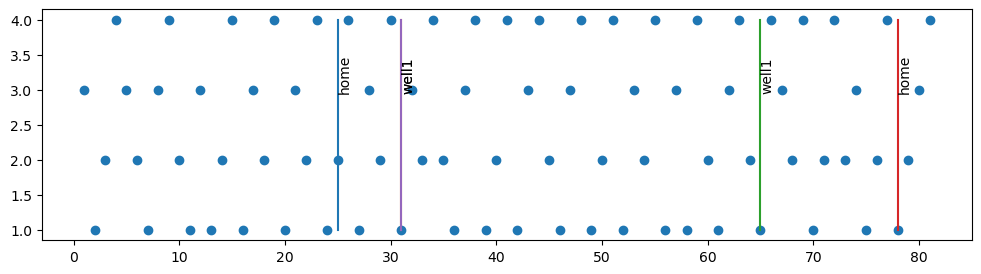

In [651]:
e = 30
u = 3
#ripple_indices = np.concatenate((frag_ripple_index[(e, u)],cont_ripple_index[(e, u)]))
ripple_indices = frag_ripple_index[(e, u)]
fig, axes = plt.subplots(1,1,figsize = (12,3))
axes.scatter(behavior.index,behavior.OuterWellIndex)
for ind in ripple_indices:
    trial = ripple_times.loc[ind].trial_number
    location = ripple_times.loc[ind].animal_location
    axes.plot([trial, trial],[1, 4])
    axes.text(trial,3,location,rotation=90)

### plot all immobolity time spiking animal location for one cell

In [661]:
from spyglass.shijiegu.singleUnit import spikeLocation


[10:00:24][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


In [663]:
behavior

,timestamp_H,Home,timestamp_O,OuterWellIndex,rewardNum,current,future_H,future_O,past,past_reward
1,1.666477e+09,1.0,1.666477e+09,3.0,2.0,3.0,3.0,1.0,NaN,NaN
2,1.666477e+09,1.0,1.666477e+09,1.0,1.0,1.0,1.0,2.0,3.0,3.0
3,1.666477e+09,1.0,1.666477e+09,2.0,1.0,2.0,2.0,4.0,1.0,3.0
4,1.666477e+09,1.0,1.666477e+09,4.0,2.0,4.0,4.0,3.0,2.0,3.0
5,1.666477e+09,1.0,1.666477e+09,3.0,1.0,3.0,3.0,2.0,4.0,4.0
...,...,...,...,...,...,...,...,...,...,...
78,1.666479e+09,1.0,1.666479e+09,1.0,1.0,1.0,1.0,2.0,4.0,1.0
79,1.666479e+09,1.0,1.666479e+09,2.0,1.0,2.0,2.0,3.0,1.0,1.0
80,1.666479e+09,1.0,1.666479e+09,3.0,2.0,3.0,3.0,4.0,2.0,1.0
81,1.666479e+09,1.0,1.666479e+09,4.0,2.0,4.0,4.0,NaN,3.0,3.0


In [664]:
e = 30
u = 3
imm_spike_time, imm_spike_loc = spikeLocation(nwb_copy_file_name, session_name, pos_name, 30, 3)

[10:04:13][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


[10:27:20][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:27:21][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:27:21][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:27:22][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:27:22][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:27:23][WARNING] Spyglass: 

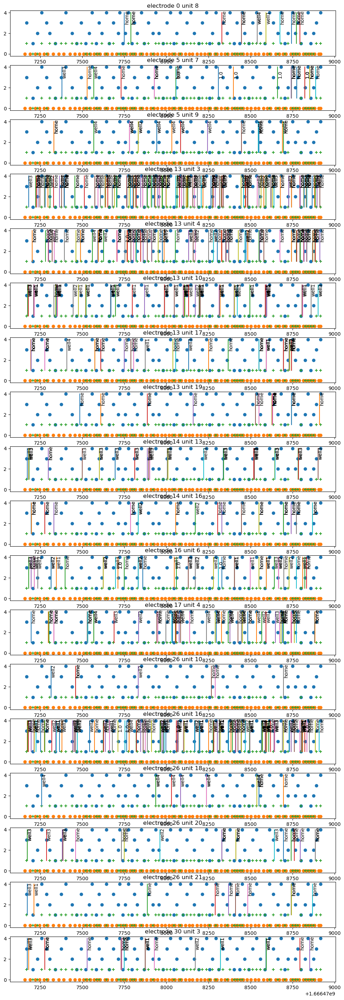

In [676]:
fig, axes = plt.subplots(len(cells_frag),1,figsize = (12,2*len(cells_frag)))

for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    imm_spike_time, imm_spike_loc = spikeLocation(nwb_copy_file_name, session_name, pos_name, e, u)

    axes[row_ind].scatter(behavior.timestamp_O,behavior.OuterWellIndex)
    axes[row_ind].scatter(behavior.timestamp_H,np.zeros_like(behavior.timestamp_H))
    axes[row_ind].scatter(behavior.timestamp_O,behavior.rewardNum == 2,marker='+')
    
    for ind in range(len(imm_spike_time)):
        t = imm_spike_time[ind]
        location = imm_spike_loc[ind]
        axes[row_ind].plot([t, t],[1, 4])
        axes[row_ind].text(t,3,location,rotation=90)
        axes[row_ind].set_title('electrode '+str(e)+' unit '+str(u))

### firing rate per cell per ripple they engaged in

In [460]:
cont_ripple_index = {}
for row_ind in range(len(cells_cont)):
    e = cells_cont[row_ind][0]
    u = cells_cont[row_ind][1]
    cont_ripple_index[(e,u)] = np.unique(ParticipatedRippleIndex(nwb_copy_file_name,session_name,
                            ripple_times,e,u,fragFlag = False))

Accepted units:  [3, 4, 6, 7, 8]
Accepted units:  [3, 4, 6, 7, 8]
Accepted units:  [3]
Accepted units:  [2, 5, 6, 7, 8, 9, 11]
Accepted units:  [2, 5, 6, 7, 8, 9, 11]
Accepted units:  [2, 5, 6, 7, 8, 9, 11]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [4, 8, 9, 10, 11, 12, 13, 16, 17, 19, 20, 21, 22]
Accepted units:  [4, 8, 9, 10, 11, 12, 13, 16, 17, 19, 20, 21, 22]
Accepted units:  [4, 8, 9, 10, 11, 12, 13, 16, 17, 19, 20, 21, 22]
Accepted units: 

In [465]:
firing_rate_per_cell_frag = []
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    (rate_F, count_F, _) = firing_rate_F[e][u]
    number_of_ripple = len(frag_ripple_index[(e,u)])
    firing_rate_per_cell_frag.append(count_F/number_of_ripple)

firing_rate_per_cell_cont = []
for row_ind in range(len(cells_cont)):
    e = cells_cont[row_ind][0]
    u = cells_cont[row_ind][1]
    (rate_C, count_C, _) = firing_rate_C[e][u]
    number_of_ripple = len(cont_ripple_index[(e,u)])
    firing_rate_per_cell_cont.append(count_C/number_of_ripple)
    

(array([0.        , 0.58928571, 0.26785714, 0.07142857, 0.        ,
        0.01785714, 0.        , 0.03571429, 0.        , 0.        ,
        0.01785714, 0.        , 0.        , 0.        ]),
 array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
        13., 14.]),
 <BarContainer object of 14 artists>)

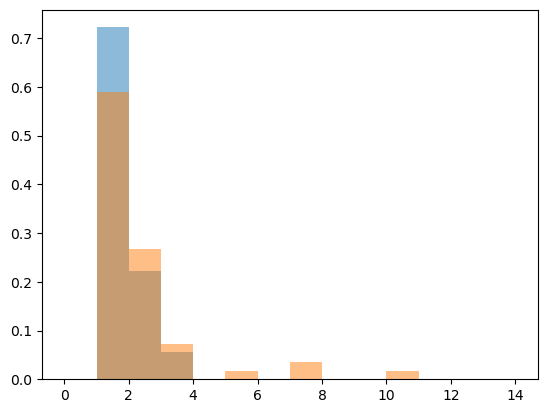

In [476]:
plt.hist(firing_rate_per_cell_frag,bins = np.arange(15),alpha = 0.5,
         weights = np.ones(len(firing_rate_per_cell_frag))/len(firing_rate_per_cell_frag))
plt.hist(firing_rate_per_cell_cont,bins = np.arange(15),alpha = 0.5,
         weights = np.ones(len(firing_rate_per_cell_cont))/len(firing_rate_per_cell_cont))

### number of ripples they participated in

In [559]:
num_frag = []
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    num_frag.append(len(frag_ripple_index[(e,u)]))

num_cont = []
for row_ind in range(len(cells_cont)):
    e = cells_cont[row_ind][0]
    u = cells_cont[row_ind][1]
    num_cont.append(len(cont_ripple_index[(e,u)]))

(array([0.        , 0.07142857, 0.10714286, 0.05357143, 0.01785714,
        0.05357143, 0.05357143, 0.        , 0.01785714, 0.03571429,
        0.03571429, 0.01785714, 0.05357143, 0.07142857]),
 array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
        13., 14.]),
 <BarContainer object of 14 artists>)

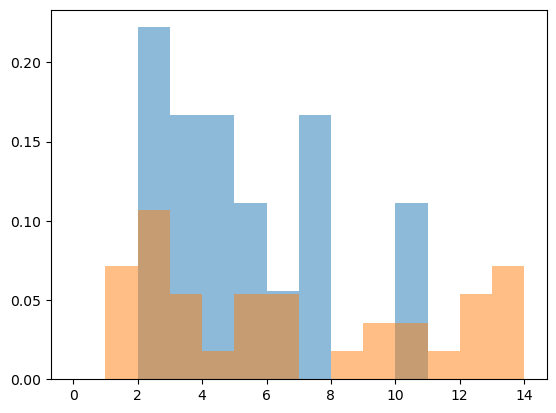

In [561]:
plt.hist(num_frag,bins = np.arange(15),alpha = 0.5,
         weights = np.ones(len(num_frag))/len(num_frag))
plt.hist(num_cont,bins = np.arange(15),alpha = 0.5,
         weights = np.ones(len(num_cont))/len(num_cont))

### sort cells by placefield and do raster

In [542]:
import track_linearization as ti
from spyglass.common.common_position import TrackGraph


In [813]:
peak1ds={}
peak1ds_list = []
cell_list = []

for sort_group_id in sort_group_ids:
    nwb_units = electrode_unit(nwb_copy_file_name,session_name,sort_group_id)
    if len(nwb_units)==0:
        continue
    for u in nwb_units.index:
        e = sort_group_id
        placefield, xbins, ybins, mobility_spike_count, all_spike_count = place_field(
            nwb_copy_file_name, session_name, pos_name, e, u)
        peak1d = placefield_to_peak1dloc('4 arm lumped 2023', placefield, ybins, xbins)
        peak1ds[(e,u)] = peak1d
        peak1ds_list.append(peak1d)
        cell_list.append((e,u))

[15:25:44][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[15:25:45][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[15:25:45][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[15:25:46][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[15:25:47][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[15:25:48][WARNING] Spyglass: 

In [1309]:
linear_map,node_location=get_linearization_map()

[14:14:28][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


In [1319]:
spatial_bins = []
segments_ind = [0,3,5,7,9]
for seg in segments_ind:
    p0p1= linear_map[seg]
    spatial_bins.append(np.linspace(p0p1[0],p0p1[1],10))
spatial_bins = np.concatenate(spatial_bins)

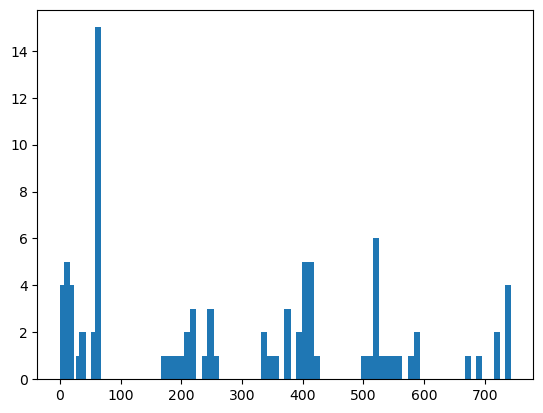

In [1320]:
# distribution of space field peak
plt.hist(peak1ds_list,spatial_bins,width = 10);

In [814]:
cells = np.array(cell_list)[np.argsort(peak1ds_list)]
cell_order = {}
for i in range(cells.shape[0]):
    cell_order[tuple(cells[i])] = i

### develop raster plot

In [577]:
from spyglass.shijiegu.Analysis_SGU import get_linearization_map
from spyglass.shijiegu.load import load_epoch_data
from spyglass.shijiegu.ripple_add_replay import plot_decode_sortedSpikes

In [571]:
TrialChoice() & {'nwb_file_name':nwb_copy_file_name}

nwb_file_name name of the NWB file,epoch the session epoch for this task and apparatus(1 based),"epoch_name session name, get from IntervalList","choice_reward pandas dataframe, choice"
eliot20221022_.nwb,2,02_Seq2Session1,=BLOB=
eliot20221022_.nwb,4,04_Seq2Session2,=BLOB=
eliot20221022_.nwb,6,06_Seq2Session3,=BLOB=
eliot20221022_.nwb,8,08_Seq2Session4,=BLOB=
eliot20221022_.nwb,10,10_Seq2Session5,=BLOB=


In [812]:
linear_map,node_location=get_linearization_map()
encoding_set = '2Dheadspeed_above_4_andlowmua'
classifier_param_name = 'default_decoding_gpu_4armMaze'
decode_threshold_method = 'MUA_0SD'
causal = False

(epoch_name,log_df,decode,head_speed,head_orientation,linear_position_df,
        lfp_df,theta_df,ripple_df,neural_df,_) = load_epoch_data(nwb_copy_file_name,8,
                                                  classifier_param_name,
                                                  encoding_set)

[15:24:37][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


epoch name 08_Seq2Session4
epoch_pos_name pos 7 valid times


[2024-07-24 15:24:37,597][WARNING]: Skipped checksum for file with hash: 6e8ac500-c1d2-7373-bab6-1ab9c9508c3e, and path: /stelmo/nwb/analysis/eliot20221022/eliot20221022_8CD94Z2Z6X.nwb


In [599]:
ripple_times.loc[ripple_table_ind].start_time

1666477296.0039346

In [742]:
peak1ds

{(0, 3): 81.3932908037696,
 (0, 4): 8.784205646541352,
 (0, 6): 245.30266794058133,
 (0, 7): 83.83532455290923,
 (0, 8): 334.6362351678518,
 (2, 3): 416.78999574439695,
 (5, 2): 11.750948844781497,
 (5, 5): 13.468537012183722,
 (5, 6): 720.3340214448474,
 (5, 7): 85.30054480239299,
 (5, 8): 499.25964754699174,
 (5, 9): 737.2425597896196,
 (5, 11): 208.10579408535483,
 (13, 2): 9.061795653394206,
 (13, 3): 722.1333009151576,
 (13, 4): 33.69790876158744,
 (13, 7): 370.0760118230974,
 (13, 8): 8.923000649967793,
 (13, 9): 741.7143846620845,
 (13, 10): 252.64353221468843,
 (13, 12): 5.487824315163371,
 (13, 13): 15.186125179585918,
 (13, 14): 418.292279561657,
 (13, 15): 414.0603300991062,
 (13, 16): 390.3994047787917,
 (13, 17): 408.5493874832986,
 (13, 18): 731.9502165919318,
 (13, 19): 8.923000649967793,
 (14, 4): 562.0255015220844,
 (14, 8): 245.30266794058133,
 (14, 9): 403.03844486749097,
 (14, 10): 518.9550799943814,
 (14, 11): 583.1876381171415,
 (14, 12): 506.3476962959938,
 (14, 

In [708]:
frag_ripple_index_all = []
for k in frag_ripple_index.keys():
    frag_ripple_index_all.append(frag_ripple_index[k])
frag_ripple_index_all = np.unique(np.concatenate(frag_ripple_index_all))

In [718]:
# savefolder related
decoding_path=(DecodeResultsLinear() & {'nwb_file_name':nwb_copy_file_name}).fetch('posterior')[0]
if causal:
    causal_str = 'causal'
else:
    causal_str = 'acausal'
savefolder = os.path.join(os.path.split(decoding_path)[0],
                        nwb_copy_file_name,
                        'sorted_spike_SWR'+'_'+encoding_set+'_'+causal_str+'_'+classifier_param_name,epoch_name)
isExist = os.path.exists(savefolder)
if not isExist:
    os.makedirs(savefolder)

In [819]:
plot_color = {}
for c in peak1ds.keys():
    plot_color[c] = 'C'+str((c[0]+c[1]) % 8 + 2)
for c in cells_cont:
    plot_color[c] = 'C1'
for c in cells_frag:
    plot_color[c] = 'C0'

In [991]:
shade_time = np.concatenate((np.array(ripple_times['start_time']).reshape((-1,1)),
                             np.array(ripple_times['end_time']).reshape((-1,1))),axis = 1)

In [ ]:
for ripple_table_ind in frag_ripple_index_all: #[19]
    plottimes = [ripple_times.loc[ripple_table_ind].start_time-1, ripple_times.loc[ripple_table_ind].end_time+1]
    savename = 'ripple_ID' + str(ripple_table_ind) + nwb_copy_file_name[:-5] + '_' + epoch_name + '2seconds'
    title = 'ripple_' + str(ripple_table_ind) + '_' + nwb_copy_file_name[:-5] + '_' + epoch_name
    #shadetimes = np.vstack(ripple_times) #all possible shadings, just np.vstack(ripples), remove empty segments
    
    plot_decode_sortedSpikes(nwb_copy_file_name,session_name,plottimes,shade_time,
                             linear_position_df,decode,lfp_df,theta_df,
              neural_df,peak1ds,head_speed,head_orientation,
              ripple_consensus_trace=None,
              title=title,savefolder=savefolder,savename=savename,
              likelihood=False,mua_thresh=0,causal = False,cell_color = plot_color)


### for each fragment only cell, plot trial by trial firing profile, with SWR shading, blue for conti, yellow for fragmented

In [ ]:
from spyglass.shijiegu.singleUnit import plot_firing_rate

In [830]:
StateScript = pd.DataFrame(
        (TrialChoice & {'nwb_file_name':nwb_copy_file_name,'epoch_name':session_name}).fetch1('choice_reward')
    )

In [ ]:
# savefolder related
decoding_path=(DecodeResultsLinear() & {'nwb_file_name':nwb_copy_file_name}).fetch('posterior')[0]
if causal:
    causal_str = 'causal'
else:
    causal_str = 'acausal'
savefolder = os.path.join(os.path.split(decoding_path)[0],
                        nwb_copy_file_name,
                        'sorted_spike_SWR'+'_'+encoding_set+'_'+causal_str+'_'+classifier_param_name,epoch_name)
isExist = os.path.exists(savefolder)
if not isExist:
    os.makedirs(savefolder)

In [ ]:
# make data matrix: from outer well to outer well
maxTime = np.nanmax(np.diff(StateScript.timestamp_O[:-1]))
DELTA_T = 0.04

cells = list(peak1ds.keys())
e_old = -1
for cell in cells:
    e = cell[0]
    u = cell[1]
    
    if e != e_old:
        nwb_units = electrode_unit(nwb_copy_file_name,session_name,e)

    # make firing rate matrix
    firing_rate_matrix = np.zeros((len(StateScript.index[:-2]), int(np.ceil(maxTime/DELTA_T)))) + np.nan
    trials = []

    row_ind = 0
    for t in StateScript.index[:-2]:
        t0 = StateScript.loc[t].timestamp_O
        t1 = StateScript.loc[t+1].timestamp_O
        axis = np.concatenate((np.arange(t0,t1,DELTA_T),np.array([t1])))
    
        spike_times = nwb_units.loc[u].spike_times
        firing_rate_matrix[row_ind,:len(axis)-1],_ = np.histogram(spike_times, axis)
        trials.append(t)
        row_ind = row_ind + 1
        
    if len(set([(e,u)]).intersection(set(cells_frag)))>0:
        savename = 'fragmented_cell_firing_rate_electrode'+str(e)+'_unit'+str(u)
    else:
        savename = 'continuous_cell_firing_rate_electrode'+str(e)+'_unit'+str(u)
    plot_firing_rate(StateScript,nwb_copy_file_name,e,u,
                 DELTA_T,trials,firing_rate_matrix,ripple_times,savefolder,savename)

### find cell assemblies during fragmented replays

In [1321]:
ripple_times.loc[157]

start_time                                    1666478744.274282
end_time                                      1666478744.410283
animal_location                                            home
trial_number                                                 72
fragmented_type                                           [[2]]
cont_intvl           [[1666478744.2750337, 1666478744.3430336]]
frag_intvl           [[1666478744.3450336, 1666478744.4090335]]
cont_intvl_replay                                         [[3]]
duration                                                  0.136
mean_zscore                                            1.791754
median_zscore                                          1.529701
max_zscore                                             3.964513
min_zscore                                            -0.355976
speed_at_start                                         2.982183
speed_at_end                                            2.98219
max_speed                               

In [1040]:
#electrodes_units[e].loc[u].spike_times

In [1041]:
# load unit data
key = {"nwb_file_name": nwb_copy_file_name,
       "sorter":"mountainsort4",
       "sort_interval_name":session_name}
sort_group_ids = np.unique((QualityMetrics & key).fetch("sort_group_id"))

sort_group_ids_with_good_cell = []       
electrodes_units = {}
for sort_group_id in sort_group_ids:
    nwb_units = electrode_unit(nwb_copy_file_name,session_name,sort_group_id)
    if len(nwb_units)==0:
        continue
    electrodes_units[sort_group_id] = nwb_units
    sort_group_ids_with_good_cell.append(sort_group_id)

In [1270]:
cells = list(peak1ds.keys())
DELTA_T = 0.1

firing_matrix_all = []
axis_all = []
r_ind_all =[]

for r_ind in ripple_times.index:
    intvls = ripple_times.loc[r_ind].frag_intvl
    
    for intvl in intvls:
        #axis_tmp = np.arange(intvl[0],intvl[1],DELTA_T)
        #axis = np.concatenate((axis_tmp,np.array([np.max([intvl[1]+DELTA_T,axis_tmp[-1]])]))) #take care of end
        axis = intvl
        firing_matrix = np.zeros((len(cells),len(axis)-1))
    
        e_old = -1
        i = 0
        for cell in cells:
            e = cell[0]
            u = cell[1]
            firing_matrix[i,:], _ = np.histogram(electrodes_units[e].loc[u].spike_times,axis)
            i = i + 1
            
        firing_matrix = firing_matrix / np.diff(intvl)
        firing_matrix_all.append(firing_matrix)
        axis_all.append(axis[:-1])
        r_ind_all.append(np.zeros_like(axis[:-1]) + r_ind)

In [1271]:
axis_all = np.concatenate(axis_all)
r_ind_all = np.concatenate(r_ind_all)
firing_matrix = np.concatenate(firing_matrix_all,axis=1)

In [1272]:
firing_matrix.shape

(90, 61)

In [1276]:
from sklearn.manifold import SpectralEmbedding

embedding = SpectralEmbedding(n_components=3,affinity='nearest_neighbors',n_neighbors=5) #n_neighbors=10
X_transformed = embedding.fit_transform(firing_matrix.T)
print(X_transformed.shape)
N = embedding.affinity_matrix_.toarray()

(61, 3)


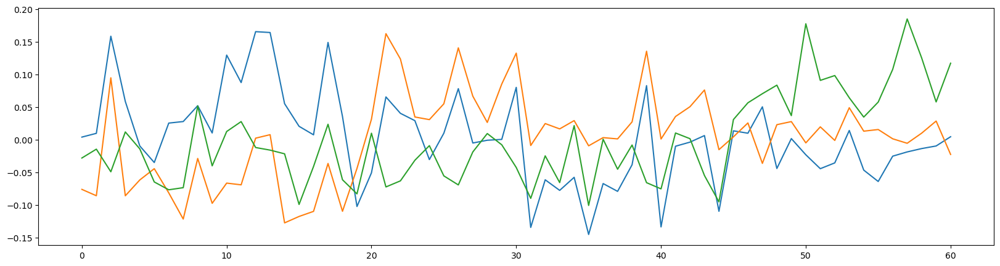

In [1280]:
replay_group = np.argmax(X_transformed,axis = 1)
sort_ind = np.argsort(replay_group)

fig,axes=plt.subplots(1,1,figsize=(20,5))
plt.plot(X_transformed[sort_ind,:])

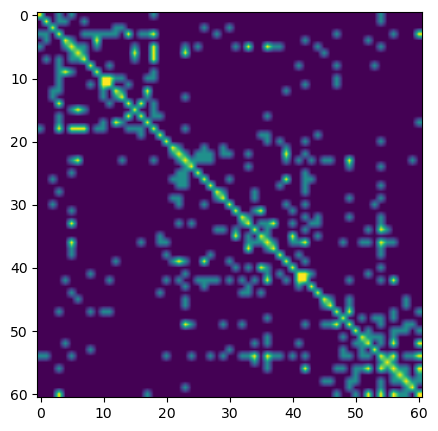

In [1281]:
%matplotlib inline

#sort_ind = np.argsort(N[10,:]) #np.argsort(N[10,:])

fig,axes=plt.subplots(1,1,figsize=(5,5))
plt.imshow(N[sort_ind,:][:,sort_ind],interpolation='bilinear', rasterized=False)

In [1282]:
#find cell groups
loading = X_transformed.T @ firing_matrix.T
C_transformed = embedding.fit_transform(loading.T)
C_transformed.shape
cell_group = np.argmax(C_transformed.T,axis=0)

In [1283]:
plot_color = {}
for cell_ind in range(len(cells)):
    e = cells[cell_ind][0]
    u = cells[cell_ind][1]
    plot_color[(e,u)] = 'C'+str(cell_group[cell_ind]+2)

In [1284]:
time_ind = np.logical_and(axis_all>=t0, axis_all<t1)

In [1285]:
ripple_times.loc[5]

start_time                                   1666477196.156844
end_time                                     1666477196.514844
animal_location                                           home
trial_number                                                 2
cont_intvl           [[1666477196.1572258, 1666477196.449226]]
frag_intvl            [[1666477196.451226, 1666477196.491226]]
cont_intvl_replay                                        [[1]]
duration                                              0.358001
mean_zscore                                           1.945267
median_zscore                                         1.670207
max_zscore                                            6.004021
min_zscore                                           -0.443112
speed_at_start                                         0.11858
speed_at_end                                          0.075129
max_speed                                              0.11858
min_speed                                             0

### ripple type and animal location

In [1290]:
ripple_times.insert(4,'fragmented_type',[[] for i in range(len(ripple_times))])

In [1294]:
for ripple_table_ind in frag_ripple_index_all: #[19]
    for intvl in ripple_times.loc[ripple_table_ind].frag_intvl:
        (t0,t1) = intvl
    
        time_ind = np.logical_and(axis_all>=t0, axis_all<t1)
        replay_group_strip = replay_group[time_ind]
        ripple_times.loc[ripple_table_ind].fragmented_type.append(replay_group_strip)

[14:05:36][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:05:36][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:05:44][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:05:44][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:05:52][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:05:52][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:01][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:01][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:09][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:09][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:17][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:17][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:25][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:25][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:32][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:32][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:40][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:40][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:56][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:56][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:04][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:04][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:11][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:11][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:27][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:27][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:35][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:35][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:43][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:43][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:51][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:51][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:59][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:59][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:07][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:07][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:15][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:15][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:26][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:26][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:33][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:33][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:41][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:41][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:56][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:56][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:04][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:04][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:12][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:12][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:20][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:20][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:27][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:27][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:35][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:35][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:43][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:43][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:50][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:50][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:58][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:58][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:10:06][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:10:06][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:10:14][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:10:14][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


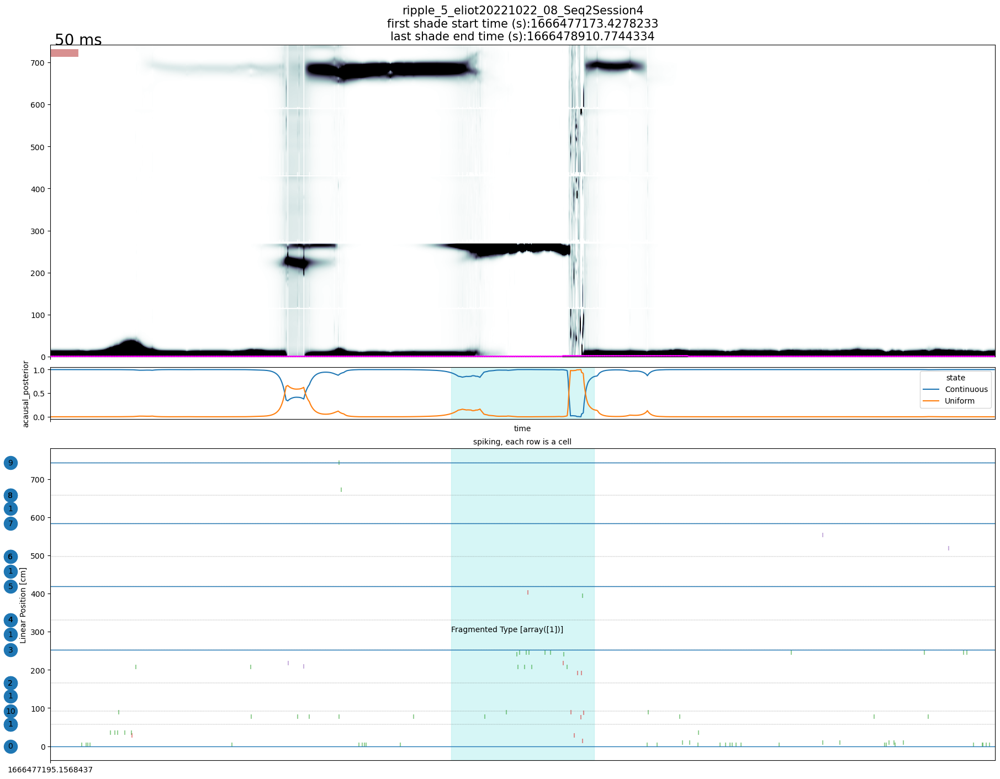

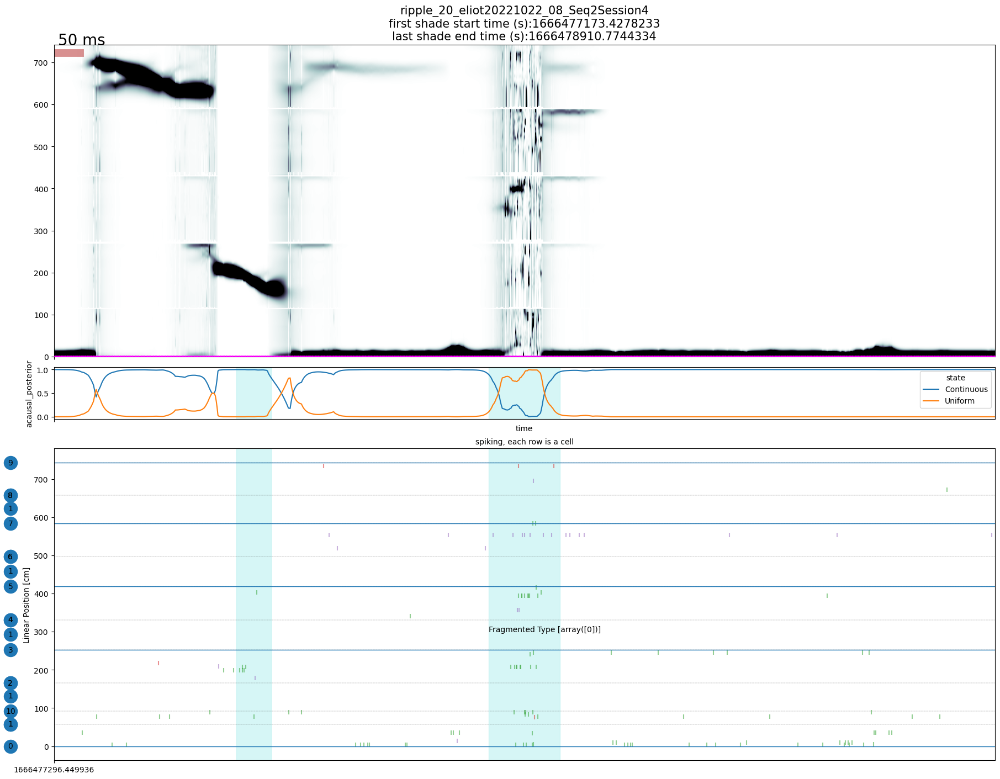

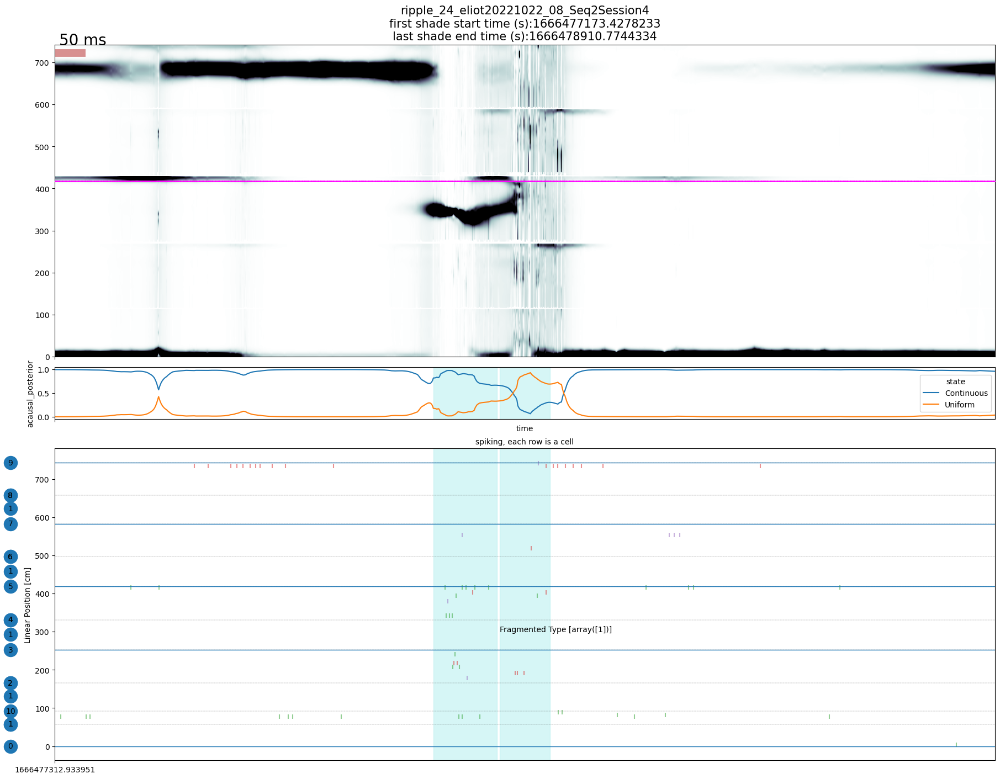

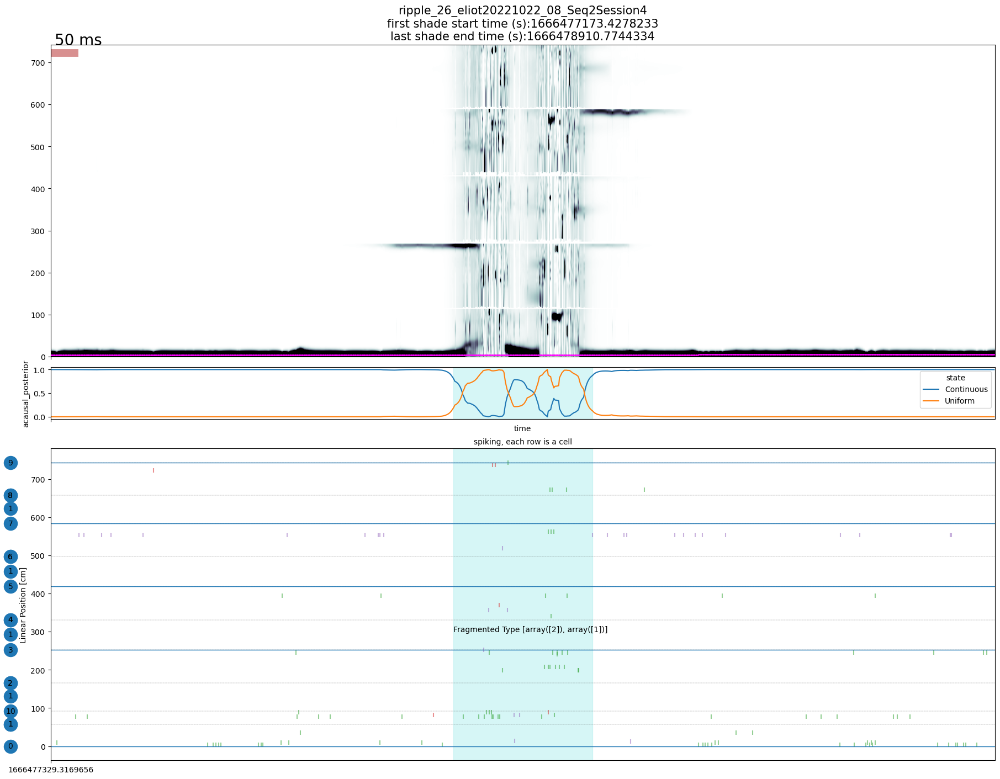

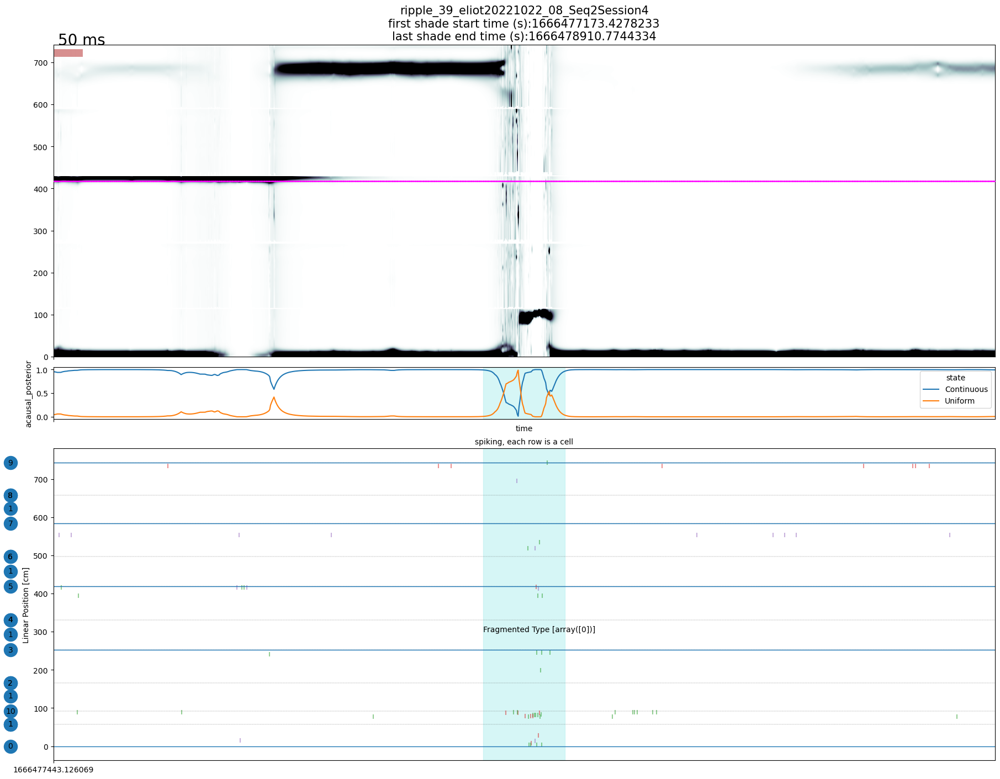

...

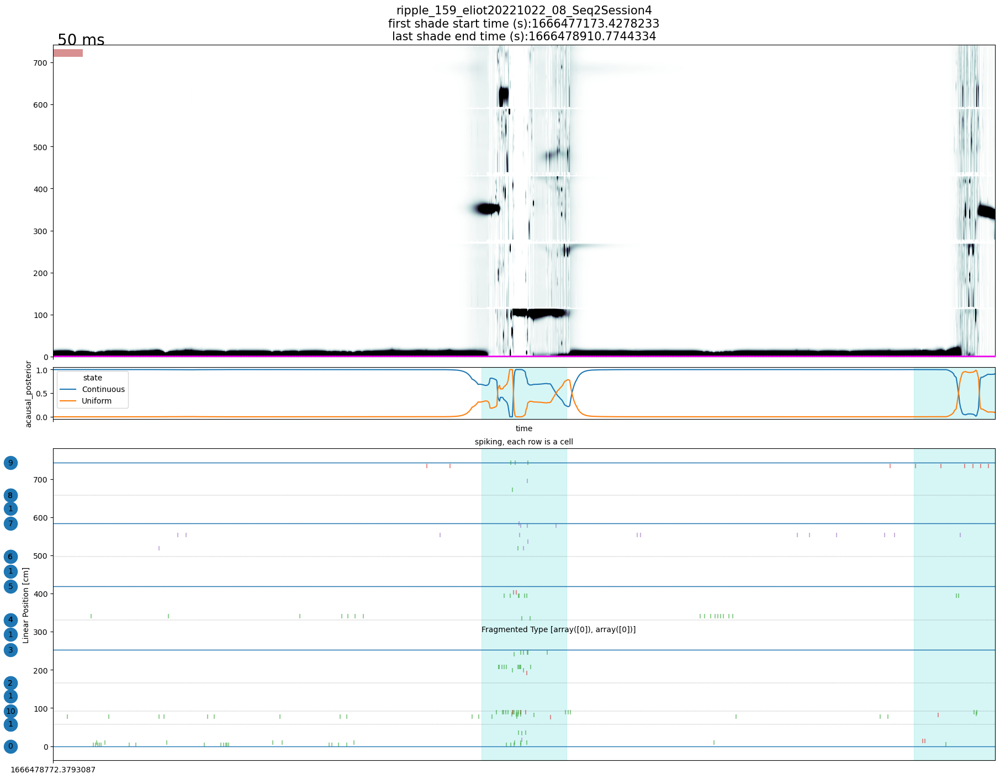

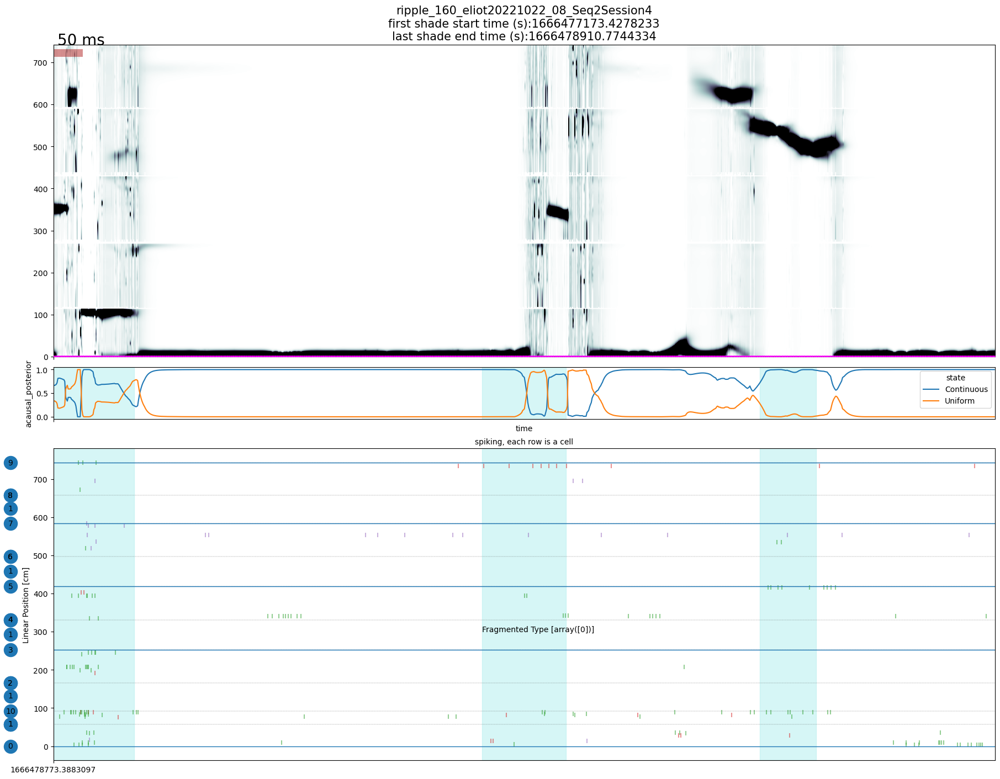

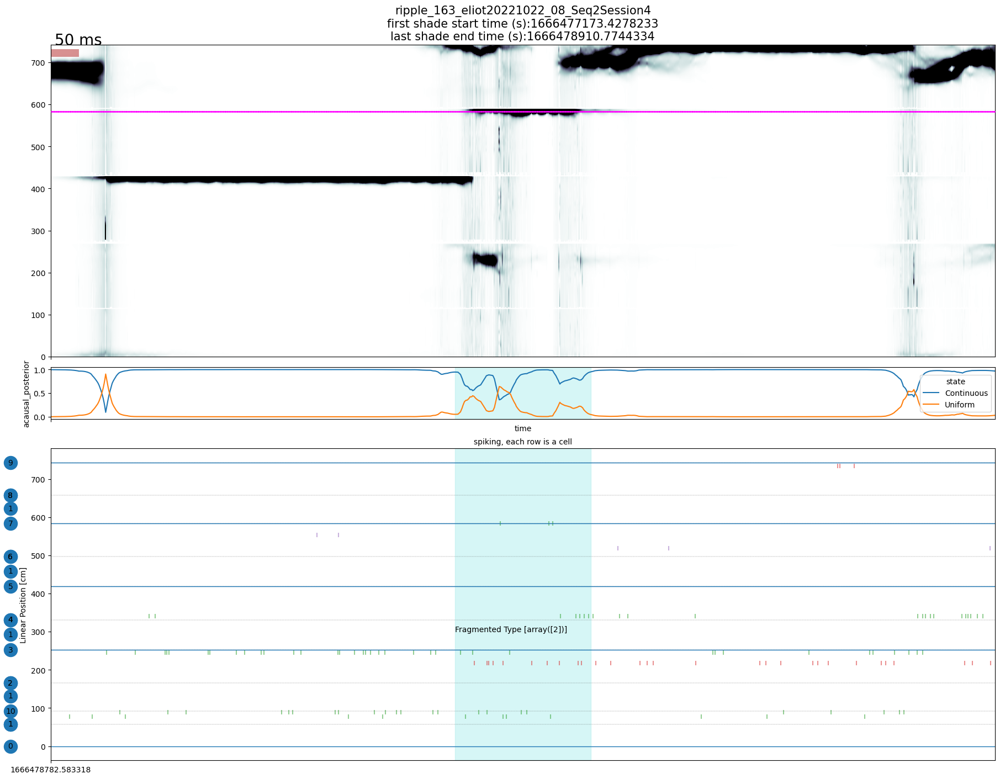

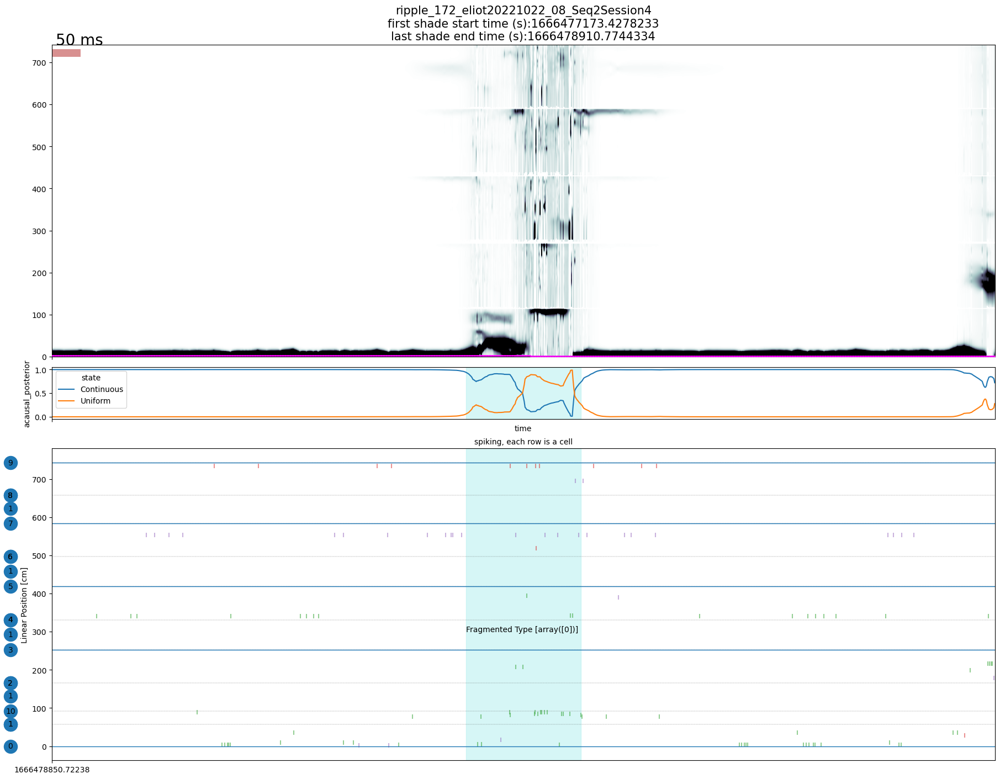

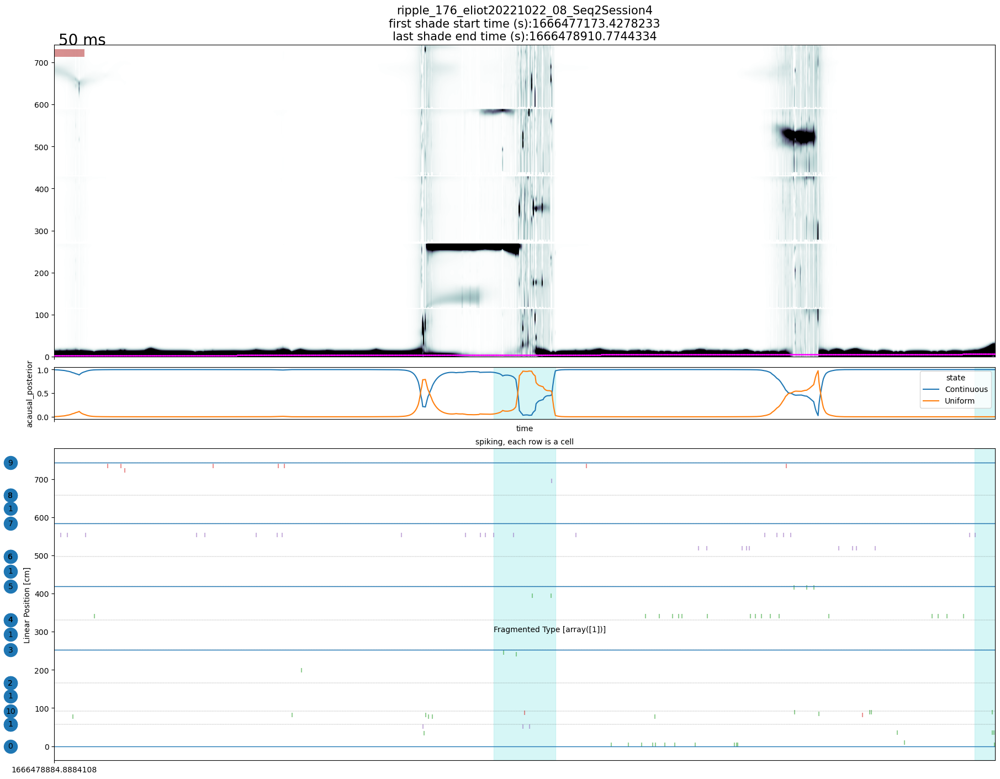

In [1307]:
# Do the same plots as above, but color with cell group

# savefolder related
decoding_path=(DecodeResultsLinear() & {'nwb_file_name':nwb_copy_file_name}).fetch('posterior')[0]
if causal:
    causal_str = 'causal'
else:
    causal_str = 'acausal'
savefolder = os.path.join(os.path.split(decoding_path)[0],
                        nwb_copy_file_name,
                        'byCellGroup_k=3_Sorted_spike_SWR'+'_'+encoding_set+'_'+causal_str+'_'+classifier_param_name,epoch_name)
isExist = os.path.exists(savefolder)
if not isExist:
    os.makedirs(savefolder)
    
for ripple_table_ind in frag_ripple_index_all: #[19]
    t0 = ripple_times.loc[ripple_table_ind].start_time
    t1 = ripple_times.loc[ripple_table_ind].end_time

    #time_ind = np.logical_and(axis_all>=t0, axis_all<t1)
    replay_group_time = t0
    replay_group_text = 'Fragmented Type '+str(ripple_times.loc[ripple_table_ind].fragmented_type)

    
    plottimes = [t0-1, t1+1]
    savename = 'ripple_ID' + str(ripple_table_ind) + nwb_copy_file_name[:-5] + '_' + epoch_name + '2seconds_cellgroups'
    title = 'ripple_' + str(ripple_table_ind) + '_' + nwb_copy_file_name[:-5] + '_' + epoch_name
    #shadetimes = np.vstack(ripple_times) #all possible shadings, just np.vstack(ripples), remove empty segments
    
    plot_decode_sortedSpikes(nwb_copy_file_name,session_name,plottimes,shade_time,
                             linear_position_df,decode,lfp_df,theta_df,
              neural_df,peak1ds,head_speed,head_orientation,
              ripple_consensus_trace=None,
              title=title,savefolder=savefolder,savename=savename,
              likelihood=False,mua_thresh=0,causal = False,cell_color = plot_color,
                             replay_type_time = replay_group_time, replay_type = replay_group_text)


In [1303]:
frag_replay_type = {}
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    ripple_indices = frag_ripple_index[(e,u)]
    frag_replay_type[(e,u)] = [ripple_times.loc[r_ind].fragmented_type for r_ind in ripple_indices]

In [1304]:
frag_replay_type

{(0, 8): [[array([1])], [array([2]), array([0])], [array([1])], [array([0])]],
 (5, 7): [[array([0])],
  [array([0])],
  [array([1]), array([1])],
  [array([0])],
  [array([0])],
  [array([0])]],
 (5, 9): [[array([2]), array([1])],
  [array([1]), array([1])],
  [array([1])],
  [array([2])],
  [array([1])]],
 (13, 3): [[array([2])], [array([1]), array([1])]],
 (13, 4): [[array([0])], [array([2]), array([0])], [array([0])], [array([0])]],
 (13, 10): [[array([2]), array([1])], [array([1]), array([1])]],
 (13, 17): [[array([2])],
  [array([1]), array([0])],
  [array([1])],
  [array([1])],
  [array([2])],
  [array([1])],
  [array([2])]],
 (13, 19): [[array([0])], [array([2])], [array([0])]],
 (14, 13): [[array([0])], [array([0]), array([0])], [array([2])]],
 (14, 16): [[array([1])],
  [array([2]), array([1])],
  [array([1]), array([1])],
  [array([1]), array([0])],
  [array([1])],
  [array([2]), array([2]), array([1])],
  [array([1])],
  [array([2])],
  [array([1]), array([1])],
  [array([0

In [1301]:
frag_type_animal_location = {}
for g in np.unique(replay_group):
    frag_type_animal_location[g] = []
    
for ripple_table_ind in frag_ripple_index_all: #[19]
    for intvl_ind in np.arange(len(ripple_times.loc[ripple_table_ind].frag_intvl)):
        animal_location = ripple_times.loc[ripple_table_ind].animal_location
        g = ripple_times.loc[ripple_table_ind].fragmented_type[intvl_ind][0]
        frag_type_animal_location[g].append(animal_location)

In [1302]:
frag_type_animal_location

{0: ['home',
  'well2',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home'],
 1: ['home',
  'well2',
  'home',
  'home',
  'home',
  'well2',
  'well2',
  'well1',
  'well1',
  'home',
  'well3',
  'well2',
  'home',
  'home',
  'home',
  'well1',
  'well1',
  'home',
  'home',
  'home',
  'home'],
 2: ['home',
  'home',
  'home',
  'well2',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'well3']}

In [1306]:
ripple_times.loc[20]

start_time                                    1666477297.449936
end_time                                      1666477297.613936
animal_location                                            home
trial_number                                                  6
fragmented_type                                           [[0]]
cont_intvl           [[1666477297.5792134, 1666477297.6132133]]
frag_intvl           [[1666477297.4732134, 1666477297.5772133]]
cont_intvl_replay                                          [[]]
duration                                                  0.164
mean_zscore                                            5.477071
median_zscore                                          2.725607
max_zscore                                            20.068431
min_zscore                                            -0.694243
speed_at_start                                         0.119185
speed_at_end                                           0.119185
max_speed                               

### find problemetic cells

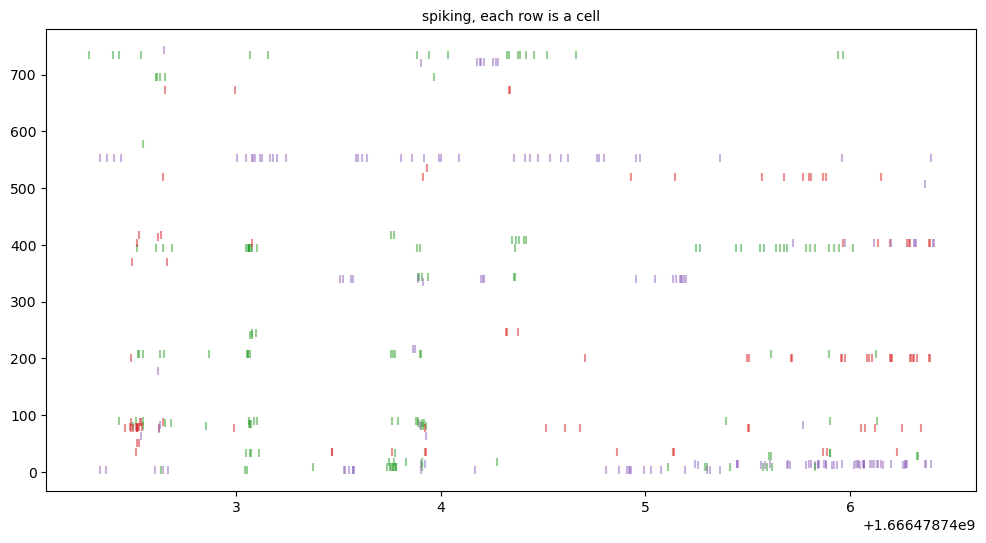

In [1119]:
fig, axes = plt.subplots(1,1,figsize = (12,6))

ripple_table_ind = 157
plottimes = [ripple_times.loc[ripple_table_ind].start_time-2, ripple_times.loc[ripple_table_ind].end_time+2]
cells = list(peak1ds.keys())
e_old = -1
for cell in cells:
    e = cell[0]
    u = cell[1]
    if e != e_old:
        nwb_units = electrode_unit(nwb_copy_file_name,session_name,e)

    spike_times = nwb_units.loc[u].spike_times
    spike_times = spike_times[np.logical_and(spike_times >= plottimes[0],spike_times <= plottimes[1])]

    #axes.scatter(spike_times, np.zeros(len(spike_times)) + peak1ds[(e,u)],rasterized=True,color = 'C'+str(u%6),marker='|',alpha = 0.5)
    axes.scatter(spike_times, np.zeros(len(spike_times)) + peak1ds[(e,u)],rasterized=True,color = plot_color[(e,u)],marker='|',alpha = 0.5)
    #axes.text(plottimes[0]-1+e/2+u/4,peak1ds[(e,u)],str(e)+' '+str(u),color = 'C'+str(u%6))
    axes.set_title('spiking, each row is a cell',size=10)
    e_old = e.copy()

array([29.705484])

In [758]:
problem_cells = [(17,2),(20,11),(23,4),(13,18)]

17 2
20 11
23 4
13 18


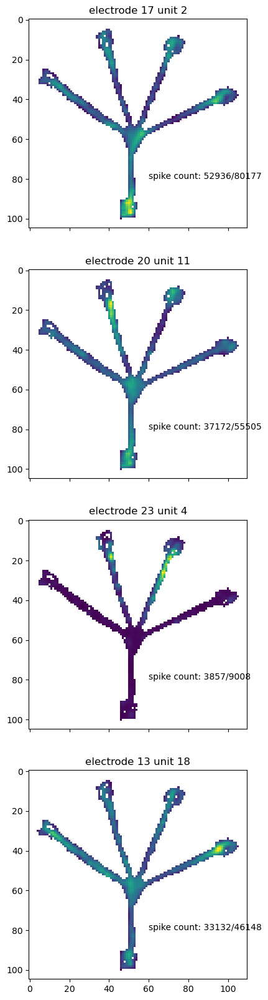

In [759]:
fig, axes = plt.subplots(len(problem_cells),1,figsize = (5,5*len(problem_cells)),sharex = 1)

row_ind = 0
#for electrode_ind in range(len(electrodes_frag)):
for row_ind in range(len(problem_cells)):
    e = problem_cells[row_ind][0]
    u = problem_cells[row_ind][1]
    print(e,u)
    placefield, xbins, ybins, mobility_spike_count, all_spike_count = place_field(nwb_copy_file_name, session_name, pos_name, e, u)
    axes[row_ind].imshow(placefield)
    axes[row_ind].text(60,80,'spike count: '+str(mobility_spike_count)+'/'+str(all_spike_count))
    axes[row_ind].set_title('electrode '+str(e) +' unit '+str(u))
        
    row_ind = row_ind + 1

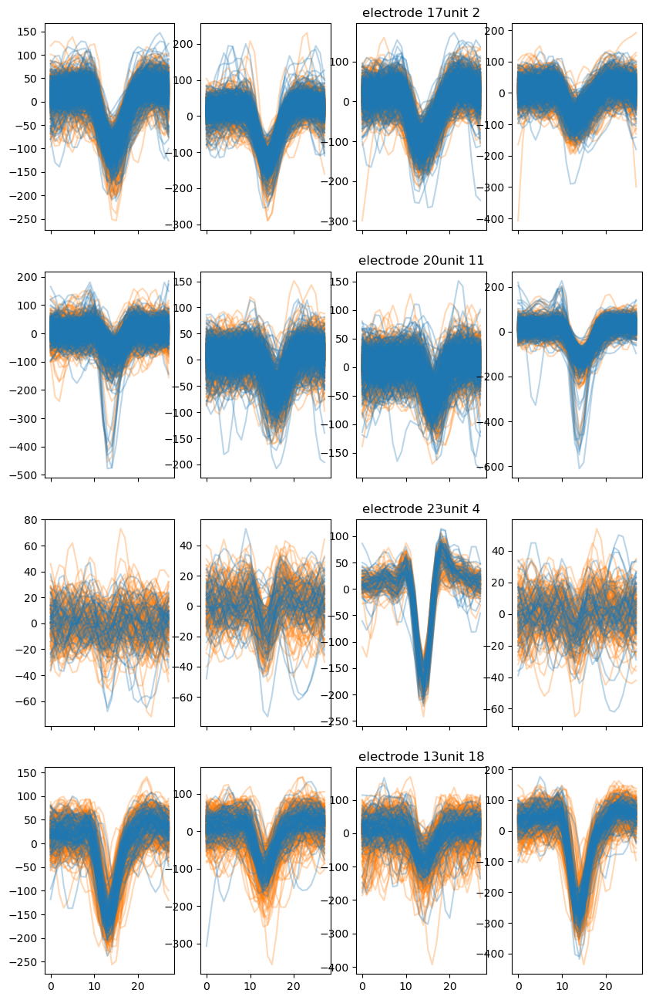

In [761]:
fig, axes = plt.subplots(len(problem_cells),4,figsize = (10,4*len(problem_cells)),sharex = 1)

row_ind = 0
for row_ind in range(len(problem_cells)):
    e = problem_cells[row_ind][0]
    u = problem_cells[row_ind][1]
    nwb_units,extractor = findWaveForms(nwb_copy_file_name,session_name,e)
    waveforms = extractor.get_waveforms(u)

    # continuous time waveforms
    ind_cont = RippleTime2Index(nwb_units.loc[u].spike_times,ripple_times,fragFlag = False)
    (sample_num,clip_size,channel_num) = waveforms.shape
    
    for s_ind in range(len(ind_cont)):
        s = ind_cont[s_ind]
        for ch in range(channel_num):
            axes[row_ind,ch].plot(waveforms[s,:,ch].squeeze(),'C1',alpha = 0.3)

    # fragmented time waveforms
    ind_frag = RippleTime2Index(nwb_units.loc[u].spike_times,ripple_times,fragFlag = True)
    (sample_num,clip_size,channel_num) = waveforms.shape
    
    for s_ind in range(len(ind_frag)):
        s = ind_frag[s_ind]
        for ch in range(channel_num):
            axes[row_ind,ch].plot(waveforms[s,:,ch].squeeze(),'C0',alpha = 0.3)
            
    axes[row_ind,2].set_title('electrode '+str(e)+'unit '+str(u))

### find patterns in the raster